## Finans Verisi

In [20]:
# Import Packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno
from sklearn import preprocessing
from scipy import stats
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import StandardScaler
import scipy.stats as ttest_ind
import scipy.stats as shapiro
from sklearn.neural_network import MLPRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn import preprocessing
import statsmodels.api as sm
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn import tree
from sklearn.linear_model import LinearRegression
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVR
from sklearn.preprocessing import scale
from sklearn.metrics import mean_squared_error,r2_score
from sklearn.tree import DecisionTreeRegressor,DecisionTreeClassifier
from sklearn.model_selection import train_test_split,cross_val_score,cross_val_predict
from scipy.stats.stats import pearsonr
from scipy.stats.stats import spearmanr
import warnings 
warnings.filterwarnings("ignore")

In [21]:
from google.colab import files
uploaded = files.upload()

Saving HW_Data_Set.xlsx to HW_Data_Set (2).xlsx


In [22]:

# Loading Data
df=pd.read_excel("HW_Data_Set.xlsx")
data=df.copy()
class Loading_Data:
    def __init__ (self,data):
        self.data=data
    def translate_to_dataframe(self):# dataset is converted to dataframe
        return pd.DataFrame(self.data).head()# the first 5 observations of the data set are shown
# Data Information
class Information:
    def __init__ (self,data):
        self.data=data
    def info_data(self):
        print(self.data.head())
        print(self.data.info())    
        print(self.data.dtypes)
        print(self.data.shape)
        print(self.data.columns)
    def describe_missing_values(self):
        print(self.data.isnull().values.any()) # Are there any missing observations in the dataset? If there is True; If there is no False returns
        print(self.data.isnull().sum())# Prints the number of missing observations on the basis of variables
    def select_dtypes_numeric(self):
        df_numeric=self.data.select_dtypes(include=['float64','int64'])# numeric variables are selected
        print(df_numeric)
    def describe_data(self):# summary statistics information of numeric variables are accessed
        df_numeric=self.data.select_dtypes(include=['float64','int64'])# numeric variables are selected
        print(self.data.describe().T)
    def select_dtypes_category(self):
        df_category=self.data.select_dtypes(include=["object"])# categorical variables are selected
        print(df_category)
        for i in df_category.columns:
            print(self.data[i].value_counts()) # Prints the frequency information of categorical variables
    def data_cor(self):
        print(self.data.corr())

# Exploratory Data Analysis (EDA)
class Visualizer:
    def __init__(self,data):
        self.data=data
    def msno_bar(self):
        plt.figure(figsize=(6,5))
        msno_bar = msno.bar(self.data,color='lightblue')
        return msno_bar
    def heat_map(self):
        df_numeric=self.data.select_dtypes(include=['float64','int64'])
        f,ax = plt.subplots(figsize=(200,200))
        return sns.heatmap(df_numeric.corr(), annot=True, linewidths=.8, fmt='.8f', ax=ax)
    def bar_plot(self,x=None,y=None,z = None):# Used to visualize barplot categorical variables
        plt.figure(figsize=(6,5))
        sns.barplot(x=x, y=y, hue=z, data=self.data)
    def box_plot(self,x=None,y=None,z=None): # continuous variables are visualized with the help of cartridges
        numeric_features=[x for x in data.columns if data[x].dtype!="object"]
        for i in data[numeric_features].columns:
            plt.figure(figsize=(6,5))
            plt.title(i)
            sns.boxplot(data=data[i])
    def hist_plot(self):
        df_numeric=self.data.select_dtypes(include=['float64','int64'])
        for i in df_numeric.columns:
            plt.figure()
            plt.hist(df_numeric[i],bins=100,color="orange")
            plt.title("Histogram of "+ i)
    def dist_plot(self,x=None,y=None,z=None):
        df_numeric=self.data.select_dtypes(include=['float64','int64'])
        df_numeric=df_numeric.dropna()
        for i in  df_numeric.columns:
            plt.figure()
            sns.distplot(np.array(df_numeric[i]),hist=False,kde=True,color="g")
            plt.title("Distplot  of "+ i)
    def reg_plot(self):
        plt.figure(figsize=(16, 7))
        df_numeric=self.data.select_dtypes(include=['float64','int64'])
        for i, column in enumerate(df_numeric.select_dtypes(exclude=['object']).columns[1:], 1):
            plt.subplot(2, 5, i)
            randNorm = np.random.normal(np.mean(df_numeric[column]), np.std(df_numeric[column]), len(df_numeric[column]))
            sns.regplot(np.sort(randNorm), np.sort(df_numeric[column]))
            plt.xlabel(f'{column}')
    def count_plot(self,x=None,y=None,z=None):
        plt.figure(figsize=(6,5))
        sns.countplot(x=x, y=y, hue=z, data=self.data)
    def correlation(self):
        fig,ax = plt.subplots(figsize=(10, 10))
        sns.heatmap(data.corr(), ax=ax, annot=True, 
        linewidths=0.05, fmt= '.2f',cmap="Blues")
        plt.show()
    def scatter_plot(self,x=None,y=None,z=None):
        return sns.scatterplot(x=x,y=y,data=self.data)
    def lm_plot(self,x=None,y=None,z=None,w=None,r=None):
        return sns.lmplot(x=x, y=y, hue=z,col=w,row=r, data=self.data)
    def swarm_plot(self,x=None,y=None,z=None):
        return sns.swarmplot(x=x, y=y,hue=z, data=self.data)
    def line_plot(self,x=None,y=None,z=None):
        return sns.lineplot(x=x,y=y,hue=z,data=self.data)
    def pair_plot(self,x=None,y=None,z=None,w=None):
        return sns.pairplot(self.data,hue=z)
    def cross_tab(self,x=None,y=None,n=None):
        numeric_features=[x for x in data.columns if data[x].dtype!="object"]
        for i in numeric_features.columns:
            return pd.crosstab(self.data[i],self.data[i],normalize=n).style.background_gradient(cmap="summer_r")
        
# Performing Hypothesis Testing
class HypothesisTesting:
    def __init__(self,data):
        self.data=data
    def normality_assumption(self):# normality assumption is realized by shapiro wilks test
        df_numeric=self.data.select_dtypes(include=['float64','int64'])
        for i in df_numeric.columns:
                df_new = df_numeric.dropna(subset=[i])
                stat, p = stats.shapiro(df_new[i])
                print("Statistics:%3.3f, p=%.3f " % (stat,p))
                alpha = 0.05
                if p>alpha:
                    print(i," için Orneklem Normal (Gaussian) Dagilimdan gelmektedir (Fail to Reject H0)")
                else:
                    print(i," için Orneklem Normal (Gaussian) Dagilimdan gelmemektedir (reject H0)")
        print("*****************************************************************************************")
    def assumption_of_variance_homogeneity(self,variable=None,x=None,y=None):#assumption of variance homogeneity is realized by levene test
        grps=pd.unique(data[variable].values)
        df_numeric=self.data.select_dtypes(include=['float64','int64'])
        for i in df_numeric.columns:
            for j in grps:
                df_new = data.dropna(subset=[i])
                stat, p = stats.levene(df_new[i][data[variable]==x],df_new[i][data[variable]==y])
                print("Statistics:%3.3f, p=%.3f " % (stat,p))
                alpha = 0.05
                if p>alpha:
                    print(i,j," için varyans homojendir. (Fail to Reject H0)")
                else:
                    print(i,j," için varyans homojen degildir. (reject H0)")
        print("*****************************************************************************************")
    # numeri amaç değişkeni - kategorik bagımsız değişken 2 sınıflı : paired t test
    # numeri amaç değişkeni - kategorik bagımsız değişken 2 den fazla sınıflı : anova
    def two_independent_samples_t_test(self,variable=None,x=None,y=None):
        df_numeric=self.data.select_dtypes(include=['float64','int64'])
        for i in df_numeric.columns:
            df_new= self.data.dropna(subset=[i])
            A=df_new[df_new[variable]==x][i]
            B=df_new[df_new[variable]==y][i]
            t, p = stats.ttest_ind(A, B, equal_var=False)
            print("ttest_ind: i=%s t = %g  p = %g" % (i,t, p))
            alpha = 0.05
            if p>alpha:
                print(i,"ile", variable," değişkeni arasında istatistiksel olarak anlamlı bir fark vardır.(Fail to Reject H0)")
            else:
                print(i," ile ", variable," değişkeni arasında istatistiksel olarak anlamlı bir fark yoktur.(reject H0)")
        print("*****************************************************************************************")
    # kategorik amaç değişkeni- kategorik bağımsız değişken : ki- kare bağımsızlık testi(chi-square)
    def chi_square_t_test(self,x=None,y=None):
        data_cross_tab=pd.crosstab(index=data[x],columns=data[y])
        chi2,p,dof,expected=stats.chi2_contingency(data_cross_tab)
        results=[["Item","Value"],
                 ["Chi-Square Test",chi2],
                 ["p - value",p]]
        print("Chi-Square Test =%g p=%g" %(chi2,p))
        alpha = 0.05
        if p>alpha:
            print(x,"ve",y," degiskenleri birbirinden bağımsızdır.(Fail to Reject H0)")
        else:
            print(x,"ve",y," degiskenleri birbirinden bağımsız değildir(reject H0)")
        print("*****************************************************************************************")
    def spearmanr_test(self,x=None):#  Korelasyon Anlamlılığı Testi için Spearman Testini kullanıcaz.---nonparametrik bir test
        df_numeric=self.data.select_dtypes(include=['float64','int64'])
        for i in df_numeric.columns:
            test_istatistigi,pvalue=stats.spearmanr(self.data[x],self.data[i])
            print('Korelasyon Katsayısı= %.4f, p- degeri=%.4f' % (test_istatistigi,pvalue))
            alpha=0.05
            if pvalue >alpha:
                print('Degiskenler arasında anlamlı bir fark yoktur, (Fail to reject)')
            else:
                print('Degiskenler arasında anlamlı bir fark vardır, (Reject)')
        print("*****************************************************************************************")

    #numeric amaç değişkeni- numeric bağımsız değişken : korelasyon analizi ve ilgili anlamlılık testi
    def pearsonr_test(self,x=None):#Korelasyon analizini pearsonr ile de gerçekleştirdim--parametrik test
        df_numeric=self.data.select_dtypes(include=['float64','int64'])
        for i in df_numeric.columns:
            test_istatistigi,pvalue=pearsonr(self.data[x],self.data[i])
            print('Korelasyon Katsayısı= %.4f, p- degeri=%.4f' % (test_istatistigi,pvalue))
            alpha=0.05
            if pvalue >alpha:
                print('Degiskenler arasında anlamlı bir fark yoktur, (Fail to reject)')
            else:
                print('Degiiskenler arasında anlamlı bir fark vardır, (Reject)')
        print("*****************************************************************************************")
# Data Preprocessing
class PreprocessStrategy:
    def __init__(self,data):
        self.data=data
    def fill_missing_value(self):
        data=self.data.dropna()
        return data.head()
    def replace_nan(self,x=None):
        return self.data.replace(x,np.nan,inplace=True)
    def fill_missing_specific_variable_with_median(self,X=None):#filling missing observations specific to the variable
        return self.data[X].fillna(self.data[X].median(),inplace=True)
    def fill_missing_value_with_mean(self):#fill in missing values in all variables with mean
        return self.data.apply(lambda x: x.fillna(x.mean()),axis=0)
    def fill_missing_value_with_median(self):#fill in missing values in all variables with median
        return self.data.apply(lambda x: x.fillna(x.median()),axis=0)
    def normalization(self):# converts variable values from 0 to 1
        return preprocessing.normalize(self.data)
    def one_hot_dummy_variable(self,variable=None):#It can be used to convert categorical variable to continuous variable. As a result, awareness among classes will be preserved.
        df_one_hot=self.data.copy()
        return pd.get_dummies(df_one_hot,columns=[variable],prefix=[variable]).head()
    def label_encoder(self,new_variable_name=None,categorical_variable_to_converted=None):# Performs conversions by the number of classes available
        lbe=preprocessing.LabelEncoder()
        data[new_variable_name]=lbe.fit_transform(data[categorical_variable_to_converted])
        return data[new_variable_name]
    def standardization(self):#a standardization is performed with an average of 0 standard deviations of one
        df_standardization=preprocessing.scale(self.data)
        return df_standardization
    def min_max_transformation(self,x=None,y=None):#Used to convert the values of a variable between two ranges that we want
        scaler=preprocessing.MinMaxScaler(feature_range=(x,y))
        return scaler.fit_transform(self.data)
    def binarize_transformation(self,threshold=None):#Converts the variable's values to 0 or 1 according to a certain threshold value
        binarizer=preprocessing.Binarizer(threshold=threshold).fit(self.data)
        return binarizer.transform(self.data)
        
        
# Data Modelling ,Performance/Evaluation metrics of the models
class GridSearchHelper():# model fit, model predict and model results are performed in this section
    def __init__(self,data):
        self.data=data
    def dataset_split(self,X_train=None,X_test=None,y_train=None,y_test=None):
        X_train,X_test,y_train,y_test= train_test_split(X,y,test_size=0.20,random_state=42)
        return X_train,X_test,y_train,y_test
    def linear_regresyon(self,X_train=None,X_test=None,y_test=None,y_train=None):
        #X= df[[x]]# x independent variable
        #y=df[[y]] # y dependent variable 
        lm=LinearRegression()
        model=lm.fit(X_train,y_train)# model object created
        return model
    def pca(self,X_train=None,X_test=None,y_test=None,y_train=None):
        pca =PCA()
        X_reduced_test= pca.fit_transform(scale(X_test))
        print(np.cumsum(np.round(pca.explained_variance_ratio_, decimals=4)*100)[0:5])
        lm=LinearRegression()
        y_train=y_train.fillna(y_train.mean())
        model=lm.fit(X_reduced_test,y_train)
        return model
    def logistic_regresyon(self,X_train=None,X_test=None,y_test=None,y_train=None,solver=None):
        loj=LogisticRegression(solver=solver)
        model=loj.fit(X_train,y_train)
        return model
    def fit_predict(self,X_test=None):
        y_pred=model.predict(X_test)
        print(y_pred)
    def show_evaluation_metrics_and_result_regression_model(self,X_test=None,y_test=None):
        print(model.intercept_)
        print(model.coef_)
        print(r2_score(y_test,y_pred))
        print(np.sqrt(mean_squared_error(y_test,model.predict(X_test))))#test error on the model
        print(np.sqrt(- cross_val_score(model,
                X_test,
                y_test,
                cv=10,
                scoring="neg_mean_squared_error")).mean())
    def show_evaluation_metrics_and_result_classification_model(self,X_test=None,y_test=None):
        print(accuracy_score(y_test,y_pred))
        print(cross_val_score(loj_model,X_test,y_test,cv=10).mean())
        print(classification_report(y_test,y_pred))
    def roc_curve(self,X_test=None,y_test=None):
        logit_roc_auc=roc_auc_score(y_test,loj_model.predict(X_test))
        fpr,tpr,threshold=roc_curve(y_test,loj_model.predict_proba(X_test)[:,1])
        plt.figure()
        plt.plot(fpr,tpr,label='AUC( area =%0.2f)' % logit_roc_auc)
        plt.plot([0,1],[0,1],'r--')
        plt.xlim([0.0,1.0])
        plt.ylim([0.0,1.05])
        plt.xlabel('False Positive Oranı')
        plt.ylabel('True Positive Oranı')
        plt.title('ROC')
        plt.show()
    def visualization_residual(self,model=None):
        return plt.plot(model.resid)


###################  Data Loading is  Done        ##################
...................  Data Information is  Loading ..................
   ind_5  ind_6  ind_8      ind_9  ...   ind_428  20_target  50_target  90_target
0     19     17  100.0  85.714286  ...  0.701906  15.135802  35.625252  36.997753
1     24     19  100.0  78.571429  ...  0.690833  15.143348  35.643013  37.016198
2     30     24  100.0  71.428571  ...  0.693040  15.146870  35.651301 -37.024805
3     37     30  100.0  64.285714  ...  0.673418  15.153283   0.000000 -37.040483
4     41     37  100.0  57.142857  ...  0.700522 -15.179065 -35.727079 -37.103503

[5 rows x 136 columns]
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6167 entries, 0 to 6166
Columns: 136 entries, ind_5 to 90_target
dtypes: float64(88), int64(45), object(3)
memory usage: 6.4+ MB
None
ind_5          int64
ind_6          int64
ind_8        float64
ind_9        float64
ind_10       float64
              ...   
ind_426      float64
ind_428      fl

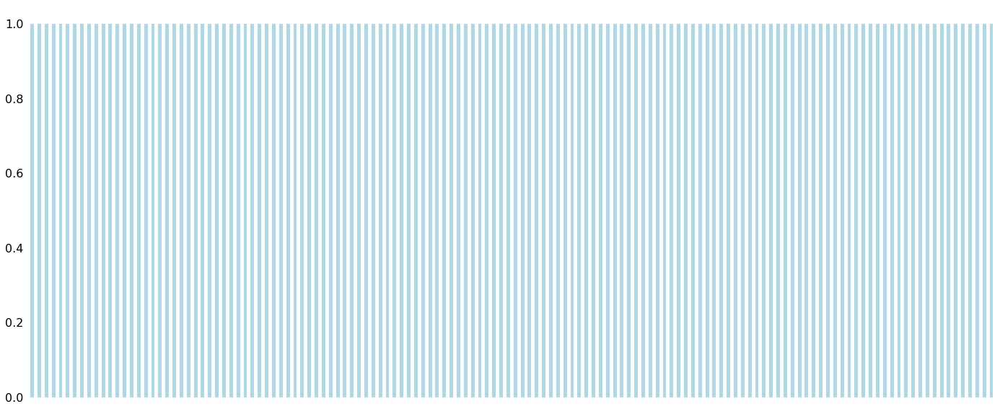

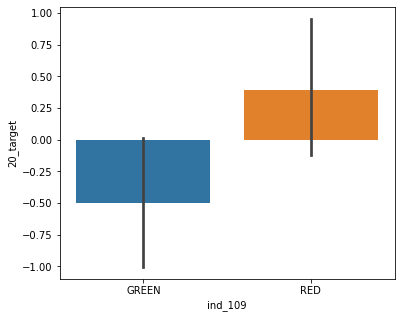

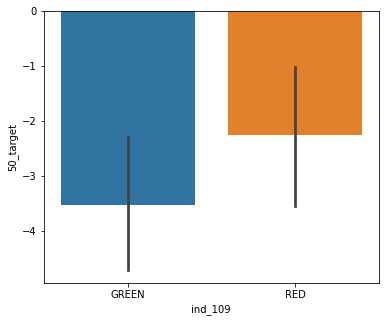

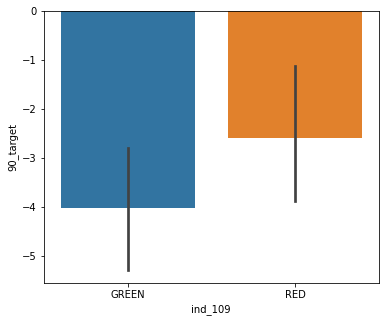

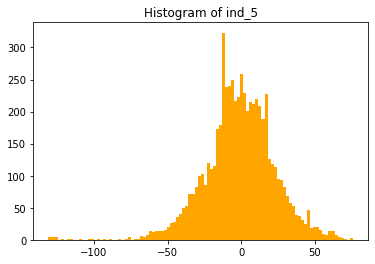

...

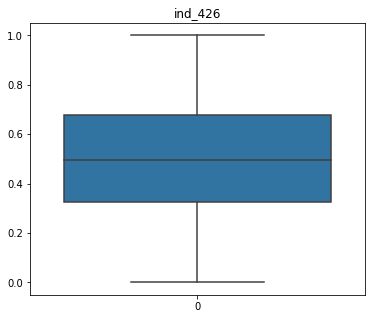

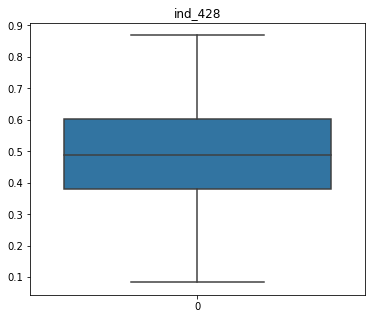

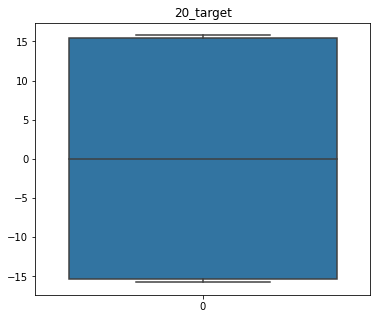

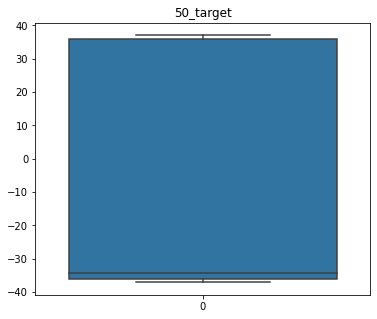

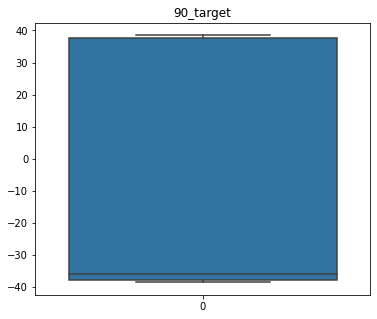

In [ ]:
# Test
loading_result=Loading_Data(data)
loading_result.translate_to_dataframe()
print("###################  Data Loading is  Done        ##################")
print("...................  Data Information is  Loading ..................")
data_information=Information(data)
data_information.info_data()
data_information.describe_missing_values()
data_information.select_dtypes_numeric()
data_information.describe_data()
data_information.select_dtypes_category()
data_information.data_cor()
prepoces_strategy=PreprocessStrategy(data)
prepoces_strategy.replace_nan(x="?")
data_information.describe_missing_values()
prepoces_strategy.fill_missing_specific_variable_with_median(X="ind_420")
prepoces_strategy.fill_missing_specific_variable_with_median(X="ind_422")
data_visualization=Visualizer(data)
data_visualization.msno_bar()
data_visualization.heat_map()
data_visualization.bar_plot(x="ind_109",y="20_target")
data_visualization.bar_plot(x="ind_109",y="50_target")
data_visualization.bar_plot(x="ind_109",y="90_target")
data_visualization.hist_plot()
data_visualization.dist_plot()
data_visualization.box_plot()
#data_visualization.correlation()

print("##################   Data Visualization is  Done     #####################")
print("..................   Hypothesis Testing is  Loading  .....................")
hypothesis_testing=HypothesisTesting(data)
hypothesis_testing.normality_assumption()
hypothesis_testing.assumption_of_variance_homogeneity(variable="ind_109",x="GREEN",y="RED")
hypothesis_testing.two_independent_samples_t_test(variable="ind_109",x="GREEN",y="RED")
hypothesis_testing.spearmanr_test(x="90_target")
hypothesis_testing.pearsonr_test(x="90_target")


#hypothesis_testing.two_independent_samples_t_test(variable="bad",x=1,y=0)
#hypothesis_testing.chi_square_t_test(x="bad",y="job")
print("##################  Hypothesis Testing is  Done      ####################")
print("##################  Hypothesis Testing is  Done      ####################")

# Model Kurma

## Simple Linear Regresyon

In [ ]:
import statsmodels.api as sm
X= df[["ind_50"]]# x bagımlı degisken
X[0:5]

,ind_50
0,-71
1,-73
2,-72
3,-74
4,-92


In [ ]:
# Bir matris işlemi için 1 sabiti eklenmeli
X=sm.add_constant(X)

In [ ]:
y=df[["90_target"]] # bagımlı degisken 
y[0:5]

,90_target
0,36.997753
1,37.016198
2,-37.024805
3,-37.040483
4,-37.103503


In [ ]:
lm=sm.OLS(y,X)# Model Kurma islemi
model=lm.fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              90_target   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     10.07
Date:                Wed, 19 Aug 2020   Prob (F-statistic):            0.00151
Time:                        09:50:57   Log-Likelihood:                -30987.
No. Observations:                6167   AIC:                         6.198e+04
Df Residuals:                    6165   BIC:                         6.199e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -3.2473      0.469     -6.920      0.000      -4.167      -2.327
ind_50        -0.0335      0.011     -3.174      0.002      -0.054      -0.013
==============================================================================
Omnibus:                    22042.592   Durbin-Watson:                   0.296
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1006.814
Skew:                           0.175   Prob(JB):                    2.36e-219
Kurtosis:                       1.052   Cond. No.                         44.6
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
model.params

const    -3.247288
ind_50   -0.033453
dtype: float64

In [ ]:
model.summary().tables[1]

,coef,std err,t,P>|t|,[0.025,0.975]
const,-3.2473,0.469,-6.920,0.000,-4.167,-2.327
ind_50,-0.0335,0.011,-3.174,0.002,-0.054,-0.013


In [ ]:
# modelin anlamlılıgına iliskin istatistiklere erişmek isteyelim
model.f_pvalue

0.0015105899252709403

In [ ]:
# pvalue
print("f_pvalue:","%4.f"% model.f_pvalue)

f_pvalue:    0


In [ ]:
# model degerlendirme istatistikleri
model.mse_model

13654.276413997635

In [ ]:
#r2 degeri - acıklanabilirlik oranı
model.rsquared

0.0016315094189159884

In [ ]:
# düzeltilmis r2 degeri
model.rsquared_adj

0.0014695680579134285

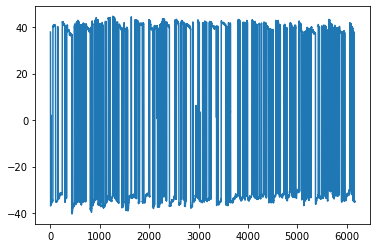

In [ ]:
#model?
from matplotlib import pyplot as plt
plt.plot(model.resid)# artıkların görsellestirilmesi


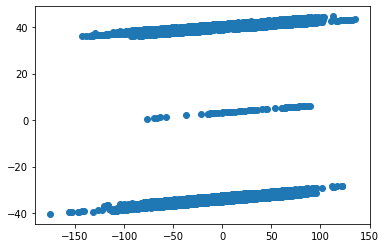

In [ ]:
# plot 
plt.scatter(model.model.exog[:,1], model.resid)
plt.show()

In [ ]:
# Model Denklemi 
print("90_target= " +str("%.2f" %model.params[0]) +"+"+ "ind_50" + "*" + str("%.2f" %model.params[1]))

90_target= -3.25+ind_50*-0.03


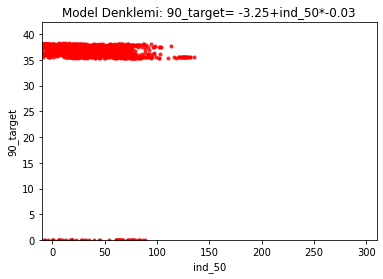

In [ ]:
from matplotlib import pyplot as plt
g=sns.regplot(df["ind_50"],df["90_target"],ci=None,scatter_kws={'color':'r','s':9})
g.set_title("Model Denklemi: 90_target= -3.25+ind_50*-0.03")
g.set_ylabel("90_target")
g.set_xlabel("ind_50")
plt.xlim(-10,310)
plt.ylim(bottom=0);


#### Scikit-learn ile model kurma 

In [ ]:
from sklearn.linear_model import LinearRegression
X=df[["ind_50"]]
y= df["90_target"]
reg=LinearRegression()
model_scikit=reg.fit(X,y)
model_scikit.intercept_
model_scikit.coef_ # b1 katsayısı

array([-0.03345295])

In [ ]:
# r2 degeridir
model_scikit.score(X,y)

0.0016315094189159884

In [ ]:
# model aracılıgıyla tahmin edilen degerleri predict ile görebiliriz.
y_pred=model_scikit.predict(X)
y_pred[0:10]

array([-0.87212799, -0.80522209, -0.83867504, -0.77176913, -0.16961597,
       -0.33688074, -0.47069255, -0.63795732, -0.87212799, -0.83867504])

In [ ]:
from sklearn.metrics import mean_squared_error,r2_score
# tahmin edilen degerler ile gercek degerlerin ortalmasının karesini hesaplıyoruz
mse=mean_squared_error(y,y_pred)
mse# hata kareler ortalaması

1354.8649954065068

In [ ]:
rmse=np.sqrt(mse)
rmse

36.80849080587938

In [ ]:
# karsılastırma tablosu
k_t=pd.DataFrame({"gercek_y":y[0:10],
                 "tahmin_y":model_scikit.predict(X)[0:10]})
k_t

,gercek_y,tahmin_y
0,36.997753,-0.872128
1,37.016198,-0.805222
2,-37.024805,-0.838675
3,-37.040483,-0.771769
4,-37.103503,-0.169616
5,-37.098277,-0.336881
6,-37.096740,-0.470693
7,-37.088440,-0.637957
8,-37.069073,-0.872128
9,-37.074913,-0.838675


In [ ]:

k_t["hata"]=k_t["gercek_y"]-k_t["tahmin_y"]
k_t

,gercek_y,tahmin_y,hata
0,36.997753,-0.872128,37.869881
1,37.016198,-0.805222,37.821420
2,-37.024805,-0.838675,-36.186130
3,-37.040483,-0.771769,-36.268714
4,-37.103503,-0.169616,-36.933887
5,-37.098277,-0.336881,-36.761396
6,-37.096740,-0.470693,-36.626047
7,-37.088440,-0.637957,-36.450482
8,-37.069073,-0.872128,-36.196945
9,-37.074913,-0.838675,-36.236238


In [ ]:
k_t["hata_kare"]= k_t["hata"]**2
k_t

,gercek_y,tahmin_y,hata,hata_kare
0,36.997753,-0.872128,37.869881,1434.127867
1,37.016198,-0.805222,37.821420,1430.459780
2,-37.024805,-0.838675,-36.186130,1309.436007
3,-37.040483,-0.771769,-36.268714,1315.419615
4,-37.103503,-0.169616,-36.933887,1364.111993
5,-37.098277,-0.336881,-36.761396,1351.400236
6,-37.096740,-0.470693,-36.626047,1341.467328
7,-37.088440,-0.637957,-36.450482,1328.637653
8,-37.069073,-0.872128,-36.196945,1310.218793
9,-37.074913,-0.838675,-36.236238,1313.064968


In [ ]:
# hata kare toplamı

sse=np.sum(k_t["hata_kare"])# sum square error
print("SSE  : "+str(sse))
# hata kare ortalması
mse=np.mean(k_t["hata_kare"])# mean square error
print("MSE  : "+str(mse))
# hata karelerinin ortalamasının  karakökü
np.sqrt(np.mean(k_t["hata_kare"]))# root mean square error
print("RMSE  : "+str(rmse))


# Not: Amacımız her zaman hatayı minimize yapacak katsayıları bulmaktır.

SSE  : 13498.344240490696
MSE  : 1349.8344240490696
RMSE  : 36.80849080587938


In [ ]:
# model?

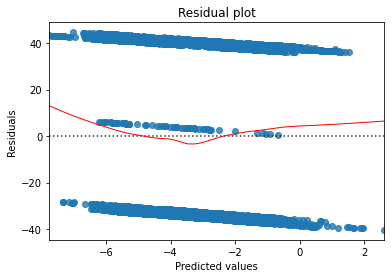

In [ ]:
# seaborn residual plot
sns.residplot(model_scikit.predict(X), df['90_target'], lowess=True, line_kws={'color':'r', 'lw':1})
plt.title('Residual plot')
plt.xlabel('Predicted values')
plt.ylabel('Residuals');

##  Multi Linear Regresyon

In [ ]:
df.replace("?",np.nan,inplace=True)
df=df.dropna()

In [ ]:
# splitting the data as train and test
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict
X=df.drop(['ind_109','50_target', '20_target','90_target'], axis=1)
y = df[["90_target"]]# hedef değişkenimiz 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=42)
X_train.shape, y_train.shape,y_test.shape,X_test.shape

((4100, 132), (4100, 1), (1026, 1), (1026, 132))

In [ ]:
lm = sm.OLS(y_train, X_train)
model_multi_linear = lm.fit()
print(model_multi_linear.summary())

                                 OLS Regression Results                                
Dep. Variable:              90_target   R-squared (uncentered):                   0.221
Model:                            OLS   Adj. R-squared (uncentered):              0.195
Method:                 Least Squares   F-statistic:                              8.542
Date:                Wed, 19 Aug 2020   Prob (F-statistic):                   7.24e-135
Time:                        09:53:06   Log-Likelihood:                         -20096.
No. Observations:                4100   AIC:                                  4.046e+04
Df Residuals:                    3968   BIC:                                  4.129e+04
Df Model:                         132                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [ ]:
#help(model_multi_linear)

In [ ]:
X_train = X_train[model_multi_linear.pvalues[model_multi_linear.pvalues <  0.05].index]
X_test=X_test[model_multi_linear.pvalues[model_multi_linear.pvalues <  0.05].index]

In [ ]:
print(X_train.shape)
print(X_test.shape)

(4100, 45)
(1026, 45)


In [ ]:
# p value değerleri 0.05 ten küçük olanlarla tekrar model kuruyoruz
lm = sm.OLS(y_train, X_train)
model_multi_linear = lm.fit()
print(model_multi_linear.summary())

                                 OLS Regression Results                                
Dep. Variable:              90_target   R-squared (uncentered):                   0.177
Model:                            OLS   Adj. R-squared (uncentered):              0.168
Method:                 Least Squares   F-statistic:                              19.43
Date:                Wed, 19 Aug 2020   Prob (F-statistic):                   5.44e-138
Time:                        09:53:12   Log-Likelihood:                         -20208.
No. Observations:                4100   AIC:                                  4.051e+04
Df Residuals:                    4055   BIC:                                  4.079e+04
Df Model:                          45                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [ ]:
# Scikit-learn ile model kurma 

In [ ]:
# splitting the data as train and test
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict
X=df.drop(['ind_109','50_target', '20_target','90_target'], axis=1)
y = df[["90_target"]]# hedef değişkenimiz 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=42)
X_train.shape, y_train.shape,y_test.shape,X_test.shape

((4100, 132), (4100, 1), (1026, 1), (1026, 132))

In [ ]:
lm=LinearRegression()
model_scikit=lm.fit(X_train,y_train)


In [ ]:
# sabit katsayı
model_scikit.intercept_

array([208.51386327])

In [ ]:
# diğer tüm  bağımsız degişken katsayıları
model_scikit.coef_

array([[ 1.06367376e+00,  4.57718384e-01, -4.23548147e+08,
         4.23548147e+08,  4.23548147e+08,  8.22336164e-01,
         4.01844176e-02,  8.54136389e-02, -2.01507256e-01,
         1.01040975e-01,  7.85449643e-01,  1.26275607e+00,
        -5.42872258e-01,  3.16186878e-01,  4.54011200e-01,
        -6.98118194e-02, -1.92052948e-01, -1.04595416e+06,
        -1.04647168e+06,  2.08842713e+06,  4.69913162e-03,
        -9.30433489e-03, -4.35909391e-02,  7.43639014e-02,
        -6.83091257e-02,  7.84221885e-02, -2.71998806e-02,
         6.68864345e-03, -1.34299487e-02,  1.48227940e-01,
        -8.03350001e-02, -1.47552349e+00,  3.68160492e-02,
         8.57188694e-01,  4.34894301e-01,  1.67479414e-01,
        -3.75538439e-01, -2.89803807e-01,  9.13641769e-01,
        -9.16628167e-02, -1.82921454e-01,  8.68355170e-01,
        -4.42755014e-01, -2.92393327e-01, -1.03943236e-02,
         1.37565345e-01,  2.28006510e+00,  4.69122088e-01,
        -9.96492095e-02, -2.55980801e-01, -2.75029833e-0

In [ ]:
# comparing the mean squared errors
from sklearn.metrics import mean_squared_error, r2_score
train_rmse = np.sqrt(mean_squared_error(y_train, model_scikit.predict(X_train)))
print('training root  mean squarred error : ', train_rmse)
test_rmse = np.sqrt(mean_squared_error(y_test, model_scikit.predict(X_test)))
print('test  root mean squarred error : ', test_rmse)

training root  mean squarred error :  32.457777763806156
test  root mean squarred error :  33.97355583055556


In [ ]:
model_scikit.score(X_train,y_train)# r2 degeri

0.21297333053101286

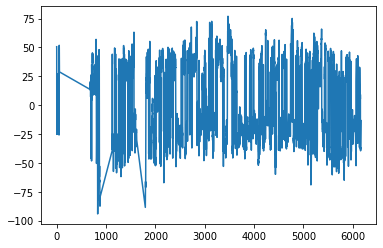

In [ ]:
# stats model ile resid attributını alabiliyoruz
# plotting the graph of resids
model_multi_linear.resid[0:10]
resid = model_multi_linear.resid.sort_index()
plt. plot(resid)
# some outliers are exist according to graph

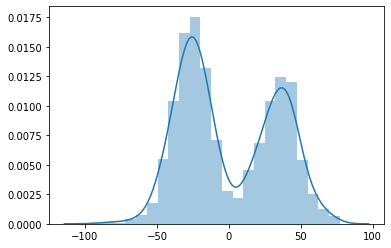

In [ ]:
sns.distplot(resid)

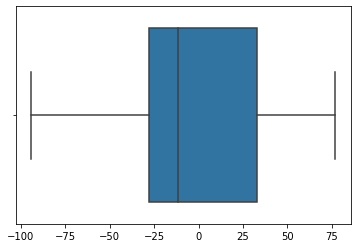

In [ ]:
sns.boxplot(resid)

In [ ]:
rmse=np.sqrt(mean_squared_error(y_train,model_scikit.predict(X_train)))
rmse # eğitim hatamız


32.457777763806156

In [ ]:
# modelin daha önce hiç görmedikleri ile hata hesaplama 
rmse=np.sqrt(mean_squared_error(y_test,model_scikit.predict(X_test)))
rmse# test hatamız

33.97355583055556

## PCA 

In [ ]:
dms=pd.get_dummies(df[["ind_109"]])
dms.head()

,ind_109_GREEN,ind_109_RED
0,1,0
1,1,0
2,1,0
3,1,0
4,1,0


In [ ]:
y=df["90_target"]
X_=df.drop(["ind_109","50_target","90_target","20_target"],axis=1).astype('float64')
X=pd.concat([X_,dms[["ind_109_GREEN","ind_109_RED"]]],axis=1)
X.head()

,ind_5,ind_6,ind_8,ind_9,ind_10,ind_12,ind_13,ind_14,ind_15,ind_16,ind_17,ind_18,ind_19,ind_20,ind_21,ind_22,ind_23,ind_25,ind_26,ind_27,ind_28,ind_29,ind_30,ind_31,ind_32,ind_33,ind_34,ind_35,ind_36,ind_37,ind_39,ind_40,ind_41,ind_42,ind_43,ind_44,ind_45,ind_46,ind_47,ind_48,...,ind_310,ind_311,ind_313,ind_315,ind_316,ind_318,ind_321,ind_324,ind_327,ind_330,ind_332,ind_334,ind_338,ind_340,ind_344,ind_345,ind_347,ind_349,ind_351,ind_352,ind_387,ind_392,ind_397,ind_399,ind_403,ind_404,ind_406,ind_407,ind_410,ind_412,ind_414,ind_416,ind_418,ind_420,ind_422,ind_424,ind_426,ind_428,ind_109_GREEN,ind_109_RED
0,19.0,17.0,100.0,85.714286,14.285714,72.363515,60.808814,23.80,17.62,11.73,12.060000,9.1100,2.0,15.0,13.0,1.0,56.0,0.002690,-0.002670,0.000010,66.666667,93.692449,146.592674,150.505806,154.486989,158.009516,142.421114,142.023350,196.592517,184.819232,31.939605,3.0,30.752568,-5.0,-22.0,-22.0,-21.0,-23.0,-36.0,-40.0,...,-1.524694,97.980028,1.179209,-0.756946,98.905563,1.190348,99.156641,-0.000062,12.056738,-0.157039,20.967742,-0.000091,1.197238,-0.319064,0.0,0.0,0.0,0.0,0.0,0.0,-3.731343,-32.587430,-26.386973,-0.003323,0.045130,-0.044678,-44.0,-23.0,-27.0,0.002371,2.0,-49.6,-54.0,-152.0,-353.0,1.0,0.498547,0.701906,1,0
1,24.0,19.0,100.0,78.571429,21.428571,74.275883,64.366798,11.45,18.16,12.22,11.326667,9.2225,0.0,11.0,11.0,1.0,63.0,0.002729,-0.003111,-0.000191,66.666667,76.694104,140.227205,156.903278,161.604303,169.720843,152.634492,149.634976,201.738617,191.985663,38.478501,3.0,36.812130,-6.0,-18.0,-24.0,-24.0,-25.0,-38.0,-43.0,...,-1.523934,97.932319,1.179223,-0.756569,98.859627,1.190389,99.111914,-0.000062,11.971831,-0.156961,20.800000,-0.000091,1.197328,-0.318905,0.0,0.0,0.0,0.0,0.0,0.0,-1.369863,-38.115965,-26.085949,-0.000476,0.035314,-0.034961,-48.0,-16.0,-31.0,0.003074,0.8,-55.6,-60.0,-158.0,-359.0,1.0,0.537088,0.690833,1,0
2,30.0,24.0,100.0,71.428571,28.571429,75.140402,65.915803,8.75,17.86,12.28,10.973333,9.3125,5.0,15.0,9.0,-1.0,65.0,0.002780,-0.003530,-0.000375,66.666667,83.909974,117.755945,154.452274,164.015689,175.947530,160.181486,155.527932,205.238017,197.993551,28.917197,3.0,39.648290,-4.0,-11.0,-21.0,-22.0,-24.0,-36.0,-42.0,...,-1.523580,97.910664,1.179236,-0.756393,98.839991,1.190429,99.093554,-0.000062,11.888112,-0.156925,20.634921,-0.000091,1.197419,-0.318831,0.0,0.0,0.0,0.0,0.0,0.0,-4.278922,-40.428126,-23.250410,-0.000309,0.005860,-0.005802,-48.0,-10.0,-30.0,0.003561,2.7,-58.4,-60.0,-160.0,-362.0,1.0,0.615169,0.693040,1,0
3,37.0,30.0,100.0,64.285714,35.714286,76.677846,68.584234,7.80,14.76,12.61,10.426667,9.4150,11.0,18.0,8.0,0.0,68.0,0.002679,-0.003961,-0.000641,66.666667,98.596644,100.147384,139.695620,158.006863,171.688382,161.192133,156.413230,203.641362,200.370912,31.449631,3.0,40.902782,-5.0,-10.0,-21.0,-23.0,-26.0,-37.0,-44.0,...,-1.522935,97.870334,1.179249,-0.756073,98.801500,1.190469,99.056290,-0.000062,11.805556,-0.156858,20.472441,-0.000091,1.197509,-0.318696,0.0,0.0,0.0,0.0,0.0,0.0,-1.355422,-45.019355,-19.499975,0.001137,-0.018252,0.018070,-51.0,-10.0,-30.0,0.004366,0.9,-61.8,-65.0,-166.0,-367.0,1.0,0.661517,0.673418,1,0
4,41.0,37.0,100.0,57.142857,42.857143,81.603007,76.455495,14.90,11.92,14.25,11.406667,9.8925,13.0,23.0,10.0,10.0,91.0,0.003986,-0.004624,-0.000319,66.666667,149.283572,124.092409,168.275524,196.846256,208.017747,193.924291,184.995906,227.848369,223.561880,50.406504,2.0,48.462194,-18.0,-26.0,-37.0,-40.0,-43.0,-53.0,-61.0,...,-1.520349,97.705214,1.179263,-0.754789,98.637028,1.190509,98.892717,-0.000062,11.724138,-0.156592,20.312500,-0.000091,1.197600,-0.318155,0.0,0.0,0.0,0.0,0.0,0.0,-0.116144,-54.849177,-25.348270,0.001552,-0.007183,0.007111,-70.0,-24.0,-45.0,0.004198,0.1,-79.8,-86.0,-186.0,-388.0,1.0,0.747204,0.700522,1,0


In [ ]:
from sklearn.model_selection import train_test_split,cross_val_score,cross_val_predict
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.25,
                                              random_state=42)
print("X_train",X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)
training= df.copy()# tüm veri seti
print("training",training.shape)

X_train (3844, 134)
y_train (3844,)
X_test (1282, 134)
y_test (1282,)
training (5126, 136)


In [ ]:
pca =PCA()# PCA nesnesi olusturuldu(değişken sayısı kadar bileşen olusturuldu)

In [ ]:
# X_train üzerinden indirgeme işlemi gerçekleştirildi
X_reduced_train= pca.fit_transform(scale(X_train))# boyut indirgeyip model kurma işlemi yaptık
X_reduced_test=pca.fit_transform(scale(X_test))

In [ ]:
# açıklanan varyansı grelim
np.cumsum(np.round(pca.explained_variance_ratio_, decimals=4)*100)[0:20]

array([36.78, 49.22, 55.34, 59.83, 63.33, 66.28, 68.79, 70.7 , 72.56,
       74.26, 75.8 , 77.23, 78.59, 79.92, 81.1 , 82.25, 83.29, 84.24,
       85.13, 85.98])

<BarContainer object of 134 artists>

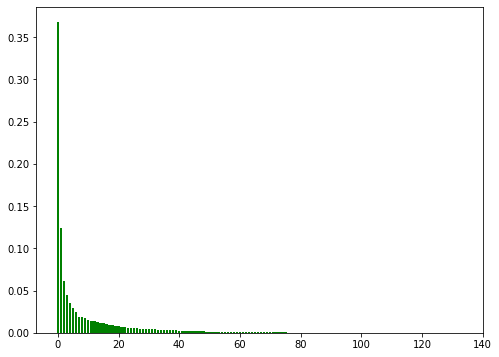

In [ ]:
import matplotlib.pyplot as plt
features= range(pca.n_components_)
plt.figure(figsize=(8,6))
plt.bar(features,pca.explained_variance_ratio_,color="green")

In [ ]:
# stats model ile linear regression kuruldu
lm=sm.OLS(y_train,X_reduced_train)# Model Kurma islemi
pca_model=lm.fit()
pca_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:              90_target   R-squared (uncentered):                   0.214
Model:                            OLS   Adj. R-squared (uncentered):              0.186
Method:                 Least Squares   F-statistic:                              7.610
Date:                Wed, 19 Aug 2020   Prob (F-statistic):                   4.68e-116
Time:                        09:53:36   Log-Likelihood:                         -18856.
No. Observations:                3844   AIC:                                  3.798e+04
Df Residuals:                    3711   BIC:                                  3.881e+04
Df Model:                         133                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.3178      0.076     -4.162      0.000      -0.467      -0.168
x2             0.3282      0.132      2.495      0.013       0.070       0.586
x3             0.9302      0.192      4.841      0.000       0.554       1.307
x4             1.5094      0.220      6.865      0.000       1.078       1.940
x5            -1.3353      0.254     -5.259      0.000      -1.833      -0.838
x6            -0.3814      0.273     -1.397      0.163      -0.917       0.154
x7            -0.6313      0.289     -2.183      0.029      -1.198      -0.064
x8             0.7200      0.327      2.204      0.028       0.079       1.361
x9            -0.9774      0.340     -2.879      0.004      -1.643      -0.312
x10            2.3697      0.354      6.685      0.000       1.675       3.065
x11            1.6518      0.368      4.492      0.000       0.931       2.373
x12            0.3705      0.383      0.967      0.334      -0.381       1.122
x13           -0.8423      0.395     -2.131      0.033      -1.617      -0.068
x14            0.0560      0.409      0.137      0.891      -0.746       0.858
x15           -0.7580      0.421     -1.800      0.072      -1.584       0.068
x16            0.9673      0.430      2.250      0.025       0.124       1.810
x17           -0.4648      0.439     -1.059      0.290      -1.326       0.396
x18            0.6001      0.485      1.238      0.216      -0.350       1.550
x19            2.6825      0.502      5.344      0.000       1.698       3.667
x20            2.5731      0.508      5.062      0.000       1.576       3.570
x21            1.0401      0.517      2.013      0.044       0.027       2.053
x22            1.8674      0.534      3.499      0.000       0.821       2.914
x23            0.8363      0.557      1.501      0.133      -0.256       1.929
x24            2.1319      0.574      3.717      0.000       1.007       3.256
x25           -1.3142      0.590     -2.226      0.026      -2.472      -0.157
x26            1.0885      0.602      1.808      0.071      -0.092       2.269
x27           -1.5217      0.631     -2.413      0.016      -2.758      -0.285
x28           -2.0085      0.652     -3.081      0.002      -3.287      -0.731
x29           -5.3352      0.675     -7.902      0.000      -6.659      -4.011
x30           -0.0195      0.702     -0.028      0.978      -1.397       1.358
x31           -1.6805      0.719     -2.338      0.019      -3.090      -0.271
x32           -1.7609      0.730     -2.414      0.016      -3.191      -0.330
x33            1.5380      0.735      2.093      0.036       0.097       2.979
x34            0.6396      0.759      0.842      0.400      -0.849       2.128
x35           -2.5437      0.784     -3.245      0.001      -

In [ ]:
pca_model.pvalues<0.05

x1       True
x2       True
x3       True
x4       True
x5       True
        ...  
x130    False
x131    False
x132    False
x133     True
x134     True
Length: 134, dtype: bool

In [ ]:
# sckit learn ile linear model kurulması
from sklearn.linear_model import LinearRegression
pca =PCA(n_components=10)
# X_train üzerinden indirgeme işlemi gerçekleştirildi
X_reduced_train= pca.fit_transform(scale(X_train))# boyut indirgeyip model kurma işlemi yaptık
X_reduced_test=pca.fit_transform(scale(X_test))
lm=LinearRegression()
pca_model=lm.fit(X_reduced_train,y_train)

In [ ]:
# açıklanan varyansı grelim
np.cumsum(np.round(pca.explained_variance_ratio_, decimals=4)*100)[0:9]

array([36.78, 49.22, 55.34, 59.83, 63.33, 66.28, 68.79, 70.7 , 72.56])

In [ ]:
pca_model.intercept_# sabit

-4.450958050920916

In [ ]:
pca_model.coef_

array([-0.31778216,  0.32822089,  0.93023155,  1.5093583 , -1.33532952,
       -0.3813641 , -0.63130039,  0.71955887, -0.97526709,  2.3689416 ])

In [ ]:
y_pred_train= pca_model.predict(X_reduced_train)
y_pred_train[0:10]

array([  3.81680691,  -5.64146313,  -4.08451907,  -7.23918147,
        -7.90598636,  -4.40938883, -11.41795815,  -3.65247582,
         4.18120077,  -9.91206286])

In [ ]:
np.sqrt(mean_squared_error(y_train,y_pred_train))# train hatası

35.848780028326225

In [ ]:
r2_score(y_train,y_pred_train)

0.040019964838460376

In [ ]:
y_pred_test= pca_model.predict(X_reduced_test)
y_pred_test[0:10]

array([ -5.48645318, -17.3632633 ,  -4.66024478,  -1.12538524,
         6.78882429,  -1.62256178,   0.69812612,  -7.30027417,
         4.41100523,  -0.99333269])

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred_test))# test hatası

37.076318012652614

In [ ]:
r2_score(y_test,y_pred_test)

-0.013957611202872311

In [ ]:
# bütün bilesenler ile kurulan modelin test hatasına bakalım
lm=LinearRegression()
pcr_model=lm.fit(X_reduced_train,y_train)
y_pred=pcr_model.predict(X_reduced_test)
np.sqrt(mean_squared_error(y_test,y_pred))

37.076318012652614

In [ ]:
# bir bilesenle bunu kuralım 
lm=LinearRegression()
pcr_model=lm.fit(X_reduced_train[:,0:1],y_train)
y_pred=pcr_model.predict(X_reduced_test[:,0:1])
print(np.sqrt(mean_squared_error(y_test,y_pred)))

36.848634965499826


In [ ]:
# iki bilesenle bunu kuralım 
lm=LinearRegression()
pcr_model=lm.fit(X_reduced_train[:,0:2],y_train)
y_pred=pcr_model.predict(X_reduced_test[:,0:2])
print(np.sqrt(mean_squared_error(y_test,y_pred)))

36.766451035047496


In [ ]:
# üç bilesenle bunu kuralım 
lm=LinearRegression()
pcr_model=lm.fit(X_reduced_train[:,0:3],y_train)
y_pred=pcr_model.predict(X_reduced_test[:,0:3])
print(np.sqrt(mean_squared_error(y_test,y_pred)))

36.84919496036269


In [ ]:
# dört bilesenle bunu kuralım 
lm=LinearRegression()
pcr_model=lm.fit(X_reduced_train[:,0:4],y_train)
y_pred=pcr_model.predict(X_reduced_test[:,0:4])
print(np.sqrt(mean_squared_error(y_test,y_pred)))

36.67334541745442


In [ ]:
# beş bilesenle bunu kuralım 
lm=LinearRegression()
pcr_model=lm.fit(X_reduced_train[:,0:5],y_train)
y_pred=pcr_model.predict(X_reduced_test[:,0:5])
print(np.sqrt(mean_squared_error(y_test,y_pred)))

36.54710127060883


In [ ]:
# yedi bilesenle bunu kuralım 
lm=LinearRegression()
pcr_model=lm.fit(X_reduced_train[:,0:7],y_train)
y_pred=pcr_model.predict(X_reduced_test[:,0:7])
print(np.sqrt(mean_squared_error(y_test,y_pred)))

36.563464457255485


In [ ]:
# on bilesenle bunu kuralım 
lm=LinearRegression()
pcr_model=lm.fit(X_reduced_train[:,0:10],y_train)
y_pred=pcr_model.predict(X_reduced_test[:,0:10])
print(np.sqrt(mean_squared_error(y_test,y_pred)))

37.076318012652614


In [ ]:
lm=LinearRegression()
pcr_model=lm.fit(X_reduced_train[:,0:20],y_train)
y_pred=pcr_model.predict(X_reduced_test[:,0:20])
print(np.sqrt(mean_squared_error(y_test,y_pred)))

37.076318012652614


In [ ]:
# Model tuning

In [ ]:
# beş bilesenle bunu kuralım 
lm=LinearRegression()
pcr_model=lm.fit(X_reduced_train[:,0:5],y_train)
y_pred=pcr_model.predict(X_reduced_test[:,0:5])
print(np.sqrt(mean_squared_error(y_test,y_pred)))

36.54710127060883


In [ ]:
from sklearn import model_selection
cv_10=model_selection.KFold(n_splits=10,shuffle=True,random_state=1)

In [ ]:
RMSE=[]
# HER BİR BİLESEN SAYISI İCİN K KATLI CROSS VALİDATİON UYGULAYIP
# HANGİ BİLESEN SAYISIININ EN AZ HATALI OLDUGUNU BİZE SÖYLEYECEK
for i in np.arange(1,X_reduced_train.shape[1]+1):
    score=np.sqrt(-1*model_selection.cross_val_score(lm,
                                                     X_reduced_train[:,:i],
                                                     y_train.values.ravel(),
                                                     cv=cv_10,
                                                    scoring="neg_mean_squared_error").mean())
    RMSE.append(score)

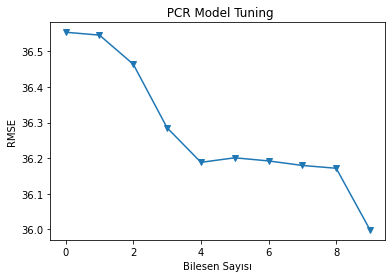

In [ ]:
plt.plot(RMSE,'-v')
plt.xlabel("Bilesen Sayısı")
plt.ylabel("RMSE")
plt.title(" PCR Model Tuning");

In [ ]:
# optimum bileşen sayısı belirlendi ve regresyon modeli tekrar kuruldu
from sklearn.linear_model import LinearRegression
pca =PCA(n_components=8)
# X_train üzerinden indirgeme işlemi gerçekleştirildi
X_reduced_train= pca.fit_transform(scale(X_train))# boyut indirgeyip model kurma işlemi yaptık
X_reduced_test=pca.fit_transform(scale(X_test))
lm=LinearRegression()
pca_model=lm.fit(X_reduced_train,y_train)

In [ ]:
# egitim hatası 
y_pred=pca_model.predict(X_reduced_train[:,0:8])
print(np.sqrt(mean_squared_error(y_train,y_pred)))

36.06020735607472


In [ ]:

# test hatası 
y_pred=pca_model.predict(X_reduced_test[:,0:8])
print(np.sqrt(mean_squared_error(y_test,y_pred)))

36.64468532545827


In [ ]:
r2_score(y_test,y_pred_test)

-0.013957611202872311

In [ ]:

import statsmodels.api as sm 
lm=sm.OLS(y_train,X_reduced_train[:,0:8])
model=lm.fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:              90_target   R-squared (uncentered):                   0.028
Model:                            OLS   Adj. R-squared (uncentered):              0.026
Method:                 Least Squares   F-statistic:                              13.94
Date:                Wed, 19 Aug 2020   Prob (F-statistic):                    3.82e-20
Time:                        09:54:05   Log-Likelihood:                         -19265.
No. Observations:                3844   AIC:                                  3.855e+04
Df Residuals:                    3836   BIC:                                  3.860e+04
Df Model:                           8                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.3178      0.084     -3.805      0.000      -0.482      -0.154
x2             0.3282      0.144      2.281      0.023       0.046       0.610
x3             0.9302      0.210      4.426      0.000       0.518       1.342
x4             1.5094      0.240      6.276      0.000       1.038       1.981
x5            -1.3353      0.278     -4.808      0.000      -1.880      -0.791
x6            -0.3812      0.299     -1.276      0.202      -0.967       0.204
x7            -0.6307      0.316     -1.994      0.046      -1.251      -0.011
x8             0.7252      0.357      2.029      0.043       0.024       1.426
==============================================================================
Omnibus:                    15258.641   Durbin-Watson:                   2.019
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              562.085
Skew:                           0.229   Prob(JB):                    8.81e-123
Kurtosis:                       1.184   Cond. No.                         4.28
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

# Decision Tree Regressor

In [ ]:
df.replace("?",np.nan,inplace=True)
df=df.dropna()

In [ ]:
dms=pd.get_dummies(df[["ind_109"]])
dms.head()

,ind_109_GREEN,ind_109_RED
0,1,0
1,1,0
2,1,0
3,1,0
4,1,0


In [ ]:
y=df["90_target"]
X_=df.drop(["ind_109","50_target","90_target","20_target"],axis=1).astype('float64')
X=pd.concat([X_,dms[["ind_109_GREEN","ind_109_RED"]]],axis=1)
X.head()

,ind_5,ind_6,ind_8,ind_9,ind_10,ind_12,ind_13,ind_14,ind_15,ind_16,ind_17,ind_18,ind_19,ind_20,ind_21,ind_22,ind_23,ind_25,ind_26,ind_27,ind_28,ind_29,ind_30,ind_31,ind_32,ind_33,ind_34,ind_35,ind_36,ind_37,ind_39,ind_40,ind_41,ind_42,ind_43,ind_44,ind_45,ind_46,ind_47,ind_48,...,ind_310,ind_311,ind_313,ind_315,ind_316,ind_318,ind_321,ind_324,ind_327,ind_330,ind_332,ind_334,ind_338,ind_340,ind_344,ind_345,ind_347,ind_349,ind_351,ind_352,ind_387,ind_392,ind_397,ind_399,ind_403,ind_404,ind_406,ind_407,ind_410,ind_412,ind_414,ind_416,ind_418,ind_420,ind_422,ind_424,ind_426,ind_428,ind_109_GREEN,ind_109_RED
0,19.0,17.0,100.0,85.714286,14.285714,72.363515,60.808814,23.80,17.62,11.73,12.060000,9.1100,2.0,15.0,13.0,1.0,56.0,0.002690,-0.002670,0.000010,66.666667,93.692449,146.592674,150.505806,154.486989,158.009516,142.421114,142.023350,196.592517,184.819232,31.939605,3.0,30.752568,-5.0,-22.0,-22.0,-21.0,-23.0,-36.0,-40.0,...,-1.524694,97.980028,1.179209,-0.756946,98.905563,1.190348,99.156641,-0.000062,12.056738,-0.157039,20.967742,-0.000091,1.197238,-0.319064,0.0,0.0,0.0,0.0,0.0,0.0,-3.731343,-32.587430,-26.386973,-0.003323,0.045130,-0.044678,-44.0,-23.0,-27.0,0.002371,2.0,-49.6,-54.0,-152.0,-353.0,1.0,0.498547,0.701906,1,0
1,24.0,19.0,100.0,78.571429,21.428571,74.275883,64.366798,11.45,18.16,12.22,11.326667,9.2225,0.0,11.0,11.0,1.0,63.0,0.002729,-0.003111,-0.000191,66.666667,76.694104,140.227205,156.903278,161.604303,169.720843,152.634492,149.634976,201.738617,191.985663,38.478501,3.0,36.812130,-6.0,-18.0,-24.0,-24.0,-25.0,-38.0,-43.0,...,-1.523934,97.932319,1.179223,-0.756569,98.859627,1.190389,99.111914,-0.000062,11.971831,-0.156961,20.800000,-0.000091,1.197328,-0.318905,0.0,0.0,0.0,0.0,0.0,0.0,-1.369863,-38.115965,-26.085949,-0.000476,0.035314,-0.034961,-48.0,-16.0,-31.0,0.003074,0.8,-55.6,-60.0,-158.0,-359.0,1.0,0.537088,0.690833,1,0
2,30.0,24.0,100.0,71.428571,28.571429,75.140402,65.915803,8.75,17.86,12.28,10.973333,9.3125,5.0,15.0,9.0,-1.0,65.0,0.002780,-0.003530,-0.000375,66.666667,83.909974,117.755945,154.452274,164.015689,175.947530,160.181486,155.527932,205.238017,197.993551,28.917197,3.0,39.648290,-4.0,-11.0,-21.0,-22.0,-24.0,-36.0,-42.0,...,-1.523580,97.910664,1.179236,-0.756393,98.839991,1.190429,99.093554,-0.000062,11.888112,-0.156925,20.634921,-0.000091,1.197419,-0.318831,0.0,0.0,0.0,0.0,0.0,0.0,-4.278922,-40.428126,-23.250410,-0.000309,0.005860,-0.005802,-48.0,-10.0,-30.0,0.003561,2.7,-58.4,-60.0,-160.0,-362.0,1.0,0.615169,0.693040,1,0
3,37.0,30.0,100.0,64.285714,35.714286,76.677846,68.584234,7.80,14.76,12.61,10.426667,9.4150,11.0,18.0,8.0,0.0,68.0,0.002679,-0.003961,-0.000641,66.666667,98.596644,100.147384,139.695620,158.006863,171.688382,161.192133,156.413230,203.641362,200.370912,31.449631,3.0,40.902782,-5.0,-10.0,-21.0,-23.0,-26.0,-37.0,-44.0,...,-1.522935,97.870334,1.179249,-0.756073,98.801500,1.190469,99.056290,-0.000062,11.805556,-0.156858,20.472441,-0.000091,1.197509,-0.318696,0.0,0.0,0.0,0.0,0.0,0.0,-1.355422,-45.019355,-19.499975,0.001137,-0.018252,0.018070,-51.0,-10.0,-30.0,0.004366,0.9,-61.8,-65.0,-166.0,-367.0,1.0,0.661517,0.673418,1,0
4,41.0,37.0,100.0,57.142857,42.857143,81.603007,76.455495,14.90,11.92,14.25,11.406667,9.8925,13.0,23.0,10.0,10.0,91.0,0.003986,-0.004624,-0.000319,66.666667,149.283572,124.092409,168.275524,196.846256,208.017747,193.924291,184.995906,227.848369,223.561880,50.406504,2.0,48.462194,-18.0,-26.0,-37.0,-40.0,-43.0,-53.0,-61.0,...,-1.520349,97.705214,1.179263,-0.754789,98.637028,1.190509,98.892717,-0.000062,11.724138,-0.156592,20.312500,-0.000091,1.197600,-0.318155,0.0,0.0,0.0,0.0,0.0,0.0,-0.116144,-54.849177,-25.348270,0.001552,-0.007183,0.007111,-70.0,-24.0,-45.0,0.004198,0.1,-79.8,-86.0,-186.0,-388.0,1.0,0.747204,0.700522,1,0


In [ ]:
from sklearn.model_selection import train_test_split,cross_val_score,cross_val_predict
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.25,
                                              random_state=42)
print("X_train",X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)
training= df.copy()# tüm veri seti
print("training",training.shape)

X_train (3844, 134)
y_train (3844,)
X_test (1282, 134)
y_test (1282,)
training (5126, 136)


In [ ]:
X_train=pd.DataFrame(X_train["ind_50"])
X_test=pd.DataFrame(X_test["ind_50"])

In [ ]:
cart_model=DecisionTreeRegressor()


In [ ]:
?cart_model

In [ ]:
cart_model.fit(X_train,y_train)

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

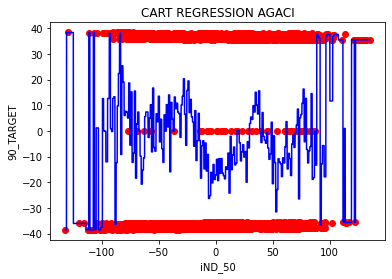

In [ ]:
X_grid=np.arange(min(np.array(X_train)),max(np.array(X_train)),0.01)
X_grid=X_grid.reshape((len(X_grid),1))
plt.scatter(X_train,y_train,color='red')
plt.plot(X_grid,cart_model.predict(X_grid),color='blue')
plt.title('CART REGRESSION AGACI')
plt.xlabel('iND_50')
plt.ylabel('90_TARGET');

In [ ]:
! pip install skompiler
from skompiler import skompile

     |████████████████████████████████| 51kB 2.2MB/s 
  Created wheel for skompiler: filename=SKompiler-0.5.5-cp36-none-any.whl size=57148 sha256=42390c63e3c50f52abdcde3000500e6de6042dfde86531af2999695609957f50
  Stored in directory: /root/.cache/pip/wheels/21/eb/99/6e32f89da503a823f6bc1a985abfdaeaa01b3a6b5ac5776d15
Successfully built skompiler


In [ ]:
print(skompile(cart_model.predict).to("python/code"))# bir karar agacının karar modelini çıkarttık

(((((((((((-38.48132721 if x[0] <= -131.0 else 38.41431121) if x[0] <= 
    -125.0 else (-36.02356138 if x[0] <= -118.0 else -36.00634626) if x[0] <=
    -114.0 else -38.4213817) if x[0] <= -111.5 else 38.39340713) if x[0] <=
    -110.5 else -38.57385848 if x[0] <= -109.5 else -38.5431172 if x[0] <= 
    -108.5 else -38.55848784) if x[0] <= -107.5 else 38.3663548) if x[0] <=
    -106.5 else -38.40775306333333) if x[0] <= -105.0 else 
    1.2035213549999995) if x[0] <= -103.0 else -38.51575745 if x[0] <= 
    -101.0 else -37.50088512333333) if x[0] <= -99.5 else ((((
    12.666537086666667 if x[0] <= -98.5 else (0.09560540000000017 if x[0] <=
    -97.5 else -0.10129253999999932) if x[0] <= -96.5 else 
    -12.000270943333334) if x[0] <= -95.0 else (12.721359043333331 if x[0] <=
    -93.5 else 38.10536128) if x[0] <= -92.5 else (0.9046392000000001 if x[
    0] <= -91.5 else -0.20258507499999823) if x[0] <= -90.5 else 
    12.742160650000002 if x[0] <= -89.5 else 13.3568839) if x[0] <= -8

###### bütün değişkenler ile model kurma 

In [ ]:
df.replace("?",np.nan,inplace=True)
df=df.dropna()

In [ ]:
dms=pd.get_dummies(df[["ind_109"]])
dms.head()

,ind_109_GREEN,ind_109_RED
0,1,0
1,1,0
2,1,0
3,1,0
4,1,0


In [ ]:
y=df["90_target"]
X_=df.drop(["ind_109","50_target","90_target","20_target"],axis=1).astype('float64')
X=pd.concat([X_,dms[["ind_109_GREEN","ind_109_RED"]]],axis=1)
X.head()

,ind_5,ind_6,ind_8,ind_9,ind_10,ind_12,ind_13,ind_14,ind_15,ind_16,ind_17,ind_18,ind_19,ind_20,ind_21,ind_22,ind_23,ind_25,ind_26,ind_27,ind_28,ind_29,ind_30,ind_31,ind_32,ind_33,ind_34,ind_35,ind_36,ind_37,ind_39,ind_40,ind_41,ind_42,ind_43,ind_44,ind_45,ind_46,ind_47,ind_48,...,ind_310,ind_311,ind_313,ind_315,ind_316,ind_318,ind_321,ind_324,ind_327,ind_330,ind_332,ind_334,ind_338,ind_340,ind_344,ind_345,ind_347,ind_349,ind_351,ind_352,ind_387,ind_392,ind_397,ind_399,ind_403,ind_404,ind_406,ind_407,ind_410,ind_412,ind_414,ind_416,ind_418,ind_420,ind_422,ind_424,ind_426,ind_428,ind_109_GREEN,ind_109_RED
0,19.0,17.0,100.0,85.714286,14.285714,72.363515,60.808814,23.80,17.62,11.73,12.060000,9.1100,2.0,15.0,13.0,1.0,56.0,0.002690,-0.002670,0.000010,66.666667,93.692449,146.592674,150.505806,154.486989,158.009516,142.421114,142.023350,196.592517,184.819232,31.939605,3.0,30.752568,-5.0,-22.0,-22.0,-21.0,-23.0,-36.0,-40.0,...,-1.524694,97.980028,1.179209,-0.756946,98.905563,1.190348,99.156641,-0.000062,12.056738,-0.157039,20.967742,-0.000091,1.197238,-0.319064,0.0,0.0,0.0,0.0,0.0,0.0,-3.731343,-32.587430,-26.386973,-0.003323,0.045130,-0.044678,-44.0,-23.0,-27.0,0.002371,2.0,-49.6,-54.0,-152.0,-353.0,1.0,0.498547,0.701906,1,0
1,24.0,19.0,100.0,78.571429,21.428571,74.275883,64.366798,11.45,18.16,12.22,11.326667,9.2225,0.0,11.0,11.0,1.0,63.0,0.002729,-0.003111,-0.000191,66.666667,76.694104,140.227205,156.903278,161.604303,169.720843,152.634492,149.634976,201.738617,191.985663,38.478501,3.0,36.812130,-6.0,-18.0,-24.0,-24.0,-25.0,-38.0,-43.0,...,-1.523934,97.932319,1.179223,-0.756569,98.859627,1.190389,99.111914,-0.000062,11.971831,-0.156961,20.800000,-0.000091,1.197328,-0.318905,0.0,0.0,0.0,0.0,0.0,0.0,-1.369863,-38.115965,-26.085949,-0.000476,0.035314,-0.034961,-48.0,-16.0,-31.0,0.003074,0.8,-55.6,-60.0,-158.0,-359.0,1.0,0.537088,0.690833,1,0
2,30.0,24.0,100.0,71.428571,28.571429,75.140402,65.915803,8.75,17.86,12.28,10.973333,9.3125,5.0,15.0,9.0,-1.0,65.0,0.002780,-0.003530,-0.000375,66.666667,83.909974,117.755945,154.452274,164.015689,175.947530,160.181486,155.527932,205.238017,197.993551,28.917197,3.0,39.648290,-4.0,-11.0,-21.0,-22.0,-24.0,-36.0,-42.0,...,-1.523580,97.910664,1.179236,-0.756393,98.839991,1.190429,99.093554,-0.000062,11.888112,-0.156925,20.634921,-0.000091,1.197419,-0.318831,0.0,0.0,0.0,0.0,0.0,0.0,-4.278922,-40.428126,-23.250410,-0.000309,0.005860,-0.005802,-48.0,-10.0,-30.0,0.003561,2.7,-58.4,-60.0,-160.0,-362.0,1.0,0.615169,0.693040,1,0
3,37.0,30.0,100.0,64.285714,35.714286,76.677846,68.584234,7.80,14.76,12.61,10.426667,9.4150,11.0,18.0,8.0,0.0,68.0,0.002679,-0.003961,-0.000641,66.666667,98.596644,100.147384,139.695620,158.006863,171.688382,161.192133,156.413230,203.641362,200.370912,31.449631,3.0,40.902782,-5.0,-10.0,-21.0,-23.0,-26.0,-37.0,-44.0,...,-1.522935,97.870334,1.179249,-0.756073,98.801500,1.190469,99.056290,-0.000062,11.805556,-0.156858,20.472441,-0.000091,1.197509,-0.318696,0.0,0.0,0.0,0.0,0.0,0.0,-1.355422,-45.019355,-19.499975,0.001137,-0.018252,0.018070,-51.0,-10.0,-30.0,0.004366,0.9,-61.8,-65.0,-166.0,-367.0,1.0,0.661517,0.673418,1,0
4,41.0,37.0,100.0,57.142857,42.857143,81.603007,76.455495,14.90,11.92,14.25,11.406667,9.8925,13.0,23.0,10.0,10.0,91.0,0.003986,-0.004624,-0.000319,66.666667,149.283572,124.092409,168.275524,196.846256,208.017747,193.924291,184.995906,227.848369,223.561880,50.406504,2.0,48.462194,-18.0,-26.0,-37.0,-40.0,-43.0,-53.0,-61.0,...,-1.520349,97.705214,1.179263,-0.754789,98.637028,1.190509,98.892717,-0.000062,11.724138,-0.156592,20.312500,-0.000091,1.197600,-0.318155,0.0,0.0,0.0,0.0,0.0,0.0,-0.116144,-54.849177,-25.348270,0.001552,-0.007183,0.007111,-70.0,-24.0,-45.0,0.004198,0.1,-79.8,-86.0,-186.0,-388.0,1.0,0.747204,0.700522,1,0


In [ ]:
from sklearn.model_selection import train_test_split,cross_val_score,cross_val_predict
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.25,
                                              random_state=42)
print("X_train",X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)
training= df.copy()# tüm veri seti
print("training",training.shape)

X_train (3844, 134)
y_train (3844,)
X_test (1282, 134)
y_test (1282,)
training (5126, 136)


In [ ]:
cart_model=DecisionTreeRegressor()


In [ ]:
cart_model.fit(X_train,y_train)

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

In [ ]:
y_pred=cart_model.predict(X_test)


In [ ]:
mean_squared_error(y_test,y_pred)# mse

508.6447843414091

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))# rmse

22.553154642785763

In [ ]:
mean_absolute_error(y_test, y_pred)# msa

7.025672727222309

In [ ]:
# Model Tuning

In [ ]:
cart_grid={"max_depth": range(2,30),
          "min_samples_split":[10,15],
          "max_leaf_nodes":range(2,10)}

In [ ]:
cart=tree.DecisionTreeRegressor()
cart_cv=GridSearchCV(cart,cart_grid,cv=10,n_jobs=-1,verbose=2)
cart_cv_model=cart_cv.fit(X_train,y_train)

Fitting 10 folds for each of 448 candidates, totalling 4480 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed:   10.8s
[Parallel(n_jobs=-1)]: Done 361 tasks      | elapsed:   25.8s
[Parallel(n_jobs=-1)]: Done 644 tasks      | elapsed:   51.9s
[Parallel(n_jobs=-1)]: Done 1009 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done 1454 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done 1981 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done 2588 tasks      | elapsed:  4.0min
[Parallel(n_jobs=-1)]: Done 3277 tasks      | elapsed:  5.1min
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:  6.3min
[Parallel(n_jobs=-1)]: Done 4480 out of 4480 | elapsed:  7.0min finished


In [ ]:
print("En iyi parametreler:"+str(cart_cv_model.best_params_))

En iyi parametreler:{'max_depth': 5, 'max_leaf_nodes': 9, 'min_samples_split': 10}


In [ ]:
cart=tree.DecisionTreeRegressor(max_depth=5,min_samples_split=10,max_leaf_nodes=9)

In [ ]:
cart_tuned=cart.fit(X_train,y_train)

In [ ]:
y_pred=cart_tuned.predict(X_test)

In [ ]:
mean_squared_error(y_test,y_pred)# mse

1070.7226117198024

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))# rmse

32.72189804580111

In [ ]:
mean_absolute_error(y_test, y_pred)# msa

28.297359499135915

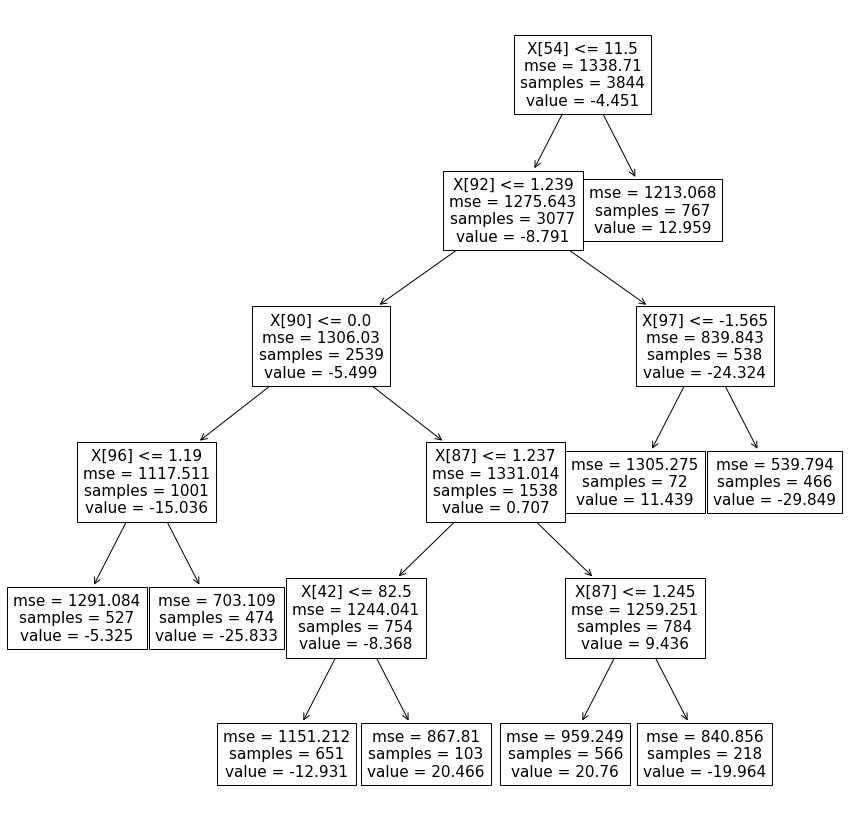

In [ ]:
plt.figure(figsize=(15,15))
tree.plot_tree(cart_tuned);

In [ ]:
# p value değerleri anlamlı olmayanlar atıldı 

In [ ]:
lm = sm.OLS(y_train, X_train)
model_multi_linear = lm.fit()
print(model_multi_linear.summary())

                            OLS Regression Results                            
Dep. Variable:              90_target   R-squared:                       0.217
Model:                            OLS   Adj. R-squared:                  0.189
Method:                 Least Squares   F-statistic:                     7.751
Date:                Wed, 19 Aug 2020   Prob (F-statistic):          7.48e-119
Time:                        10:09:03   Log-Likelihood:                -18820.
No. Observations:                3844   AIC:                         3.791e+04
Df Residuals:                    3710   BIC:                         3.875e+04
Df Model:                         133                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
ind_5             1.0238      1.007      1.017

In [ ]:
X_train = X_train[model_multi_linear.pvalues[model_multi_linear.pvalues <  0.05].index]
X_test=X_test[model_multi_linear.pvalues[model_multi_linear.pvalues <  0.05].index]

In [ ]:
cart_model=DecisionTreeRegressor()

In [ ]:
cart_model.fit(X_train,y_train)

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

In [ ]:
y_pred=cart_model.predict(X_test)

In [ ]:
mean_squared_error(y_test,y_pred)# mse

440.1993192163626

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))# rmse

20.980927510869545

In [ ]:
mean_absolute_error(y_test, y_pred)# msa

6.099531017663806

In [ ]:
cart_grid={"max_depth": range(2,30),
          "min_samples_split":[10,15],
          "max_leaf_nodes":range(2,10)}

In [ ]:
cart=tree.DecisionTreeRegressor()
cart_cv=GridSearchCV(cart,cart_grid,cv=10,n_jobs=-1,verbose=2)
cart_cv_model=cart_cv.fit(X_train,y_train)

Fitting 10 folds for each of 448 candidates, totalling 4480 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  86 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 570 tasks      | elapsed:   14.1s
[Parallel(n_jobs=-1)]: Done 1382 tasks      | elapsed:   36.0s
[Parallel(n_jobs=-1)]: Done 2514 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 3974 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done 4480 out of 4480 | elapsed:  2.1min finished


In [ ]:
print("En iyi parametreler:"+str(cart_cv_model.best_params_))

En iyi parametreler:{'max_depth': 5, 'max_leaf_nodes': 9, 'min_samples_split': 10}


In [ ]:
cart=tree.DecisionTreeRegressor(max_depth=5,min_samples_split=10,max_leaf_nodes=9)

In [ ]:
cart_tuned=cart.fit(X_train,y_train)

In [ ]:
y_pred=cart_tuned.predict(X_test)

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))# rmse

33.05724378193238

In [ ]:
mean_squared_error(y_test,y_pred)# mse

1092.781366458107

In [ ]:
mean_absolute_error(y_test, y_pred)# msa

28.888981342664927

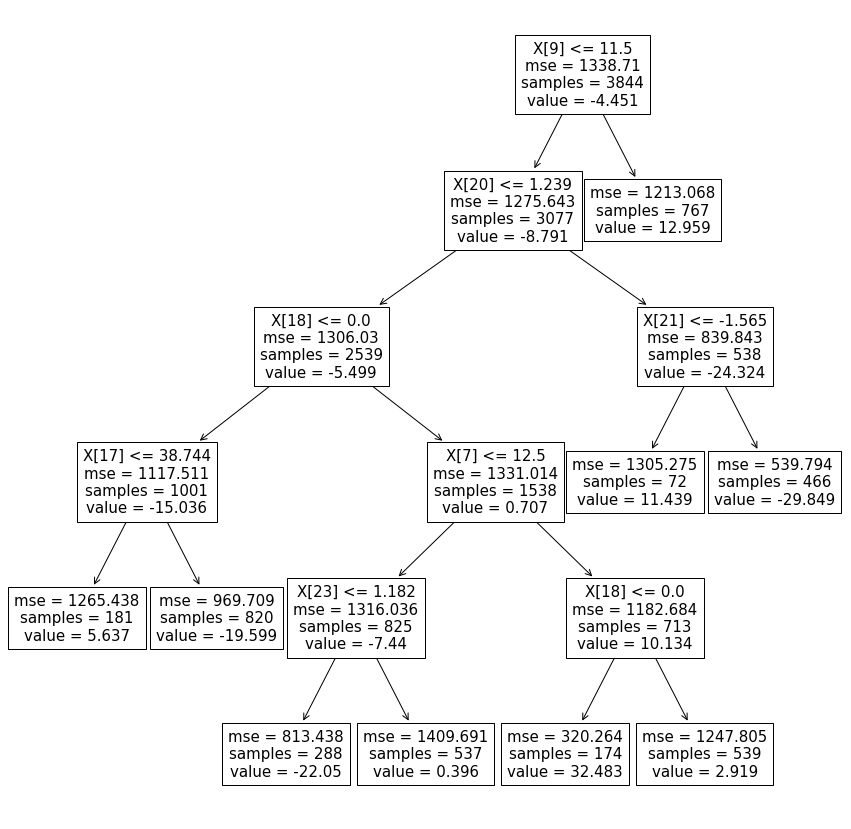

In [ ]:
plt.figure(figsize=(15,15))
tree.plot_tree(cart_tuned);

# Random Forest Regressor 

In [ ]:
df.replace("?",np.nan,inplace=True)
df=df.dropna()

In [ ]:
dms=pd.get_dummies(df[["ind_109"]])
dms.head()

,ind_109_GREEN,ind_109_RED
0,1,0
1,1,0
2,1,0
3,1,0
4,1,0


In [ ]:
y=df["90_target"]
X_=df.drop(["ind_109","50_target","90_target","20_target"],axis=1).astype('float64')
X=pd.concat([X_,dms[["ind_109_GREEN","ind_109_RED"]]],axis=1)
X.head()

,ind_5,ind_6,ind_8,ind_9,ind_10,ind_12,ind_13,ind_14,ind_15,ind_16,ind_17,ind_18,ind_19,ind_20,ind_21,ind_22,ind_23,ind_25,ind_26,ind_27,ind_28,ind_29,ind_30,ind_31,ind_32,ind_33,ind_34,ind_35,ind_36,ind_37,ind_39,ind_40,ind_41,ind_42,ind_43,ind_44,ind_45,ind_46,ind_47,ind_48,...,ind_310,ind_311,ind_313,ind_315,ind_316,ind_318,ind_321,ind_324,ind_327,ind_330,ind_332,ind_334,ind_338,ind_340,ind_344,ind_345,ind_347,ind_349,ind_351,ind_352,ind_387,ind_392,ind_397,ind_399,ind_403,ind_404,ind_406,ind_407,ind_410,ind_412,ind_414,ind_416,ind_418,ind_420,ind_422,ind_424,ind_426,ind_428,ind_109_GREEN,ind_109_RED
0,19.0,17.0,100.0,85.714286,14.285714,72.363515,60.808814,23.80,17.62,11.73,12.060000,9.1100,2.0,15.0,13.0,1.0,56.0,0.002690,-0.002670,0.000010,66.666667,93.692449,146.592674,150.505806,154.486989,158.009516,142.421114,142.023350,196.592517,184.819232,31.939605,3.0,30.752568,-5.0,-22.0,-22.0,-21.0,-23.0,-36.0,-40.0,...,-1.524694,97.980028,1.179209,-0.756946,98.905563,1.190348,99.156641,-0.000062,12.056738,-0.157039,20.967742,-0.000091,1.197238,-0.319064,0.0,0.0,0.0,0.0,0.0,0.0,-3.731343,-32.587430,-26.386973,-0.003323,0.045130,-0.044678,-44.0,-23.0,-27.0,0.002371,2.0,-49.6,-54.0,-152.0,-353.0,1.0,0.498547,0.701906,1,0
1,24.0,19.0,100.0,78.571429,21.428571,74.275883,64.366798,11.45,18.16,12.22,11.326667,9.2225,0.0,11.0,11.0,1.0,63.0,0.002729,-0.003111,-0.000191,66.666667,76.694104,140.227205,156.903278,161.604303,169.720843,152.634492,149.634976,201.738617,191.985663,38.478501,3.0,36.812130,-6.0,-18.0,-24.0,-24.0,-25.0,-38.0,-43.0,...,-1.523934,97.932319,1.179223,-0.756569,98.859627,1.190389,99.111914,-0.000062,11.971831,-0.156961,20.800000,-0.000091,1.197328,-0.318905,0.0,0.0,0.0,0.0,0.0,0.0,-1.369863,-38.115965,-26.085949,-0.000476,0.035314,-0.034961,-48.0,-16.0,-31.0,0.003074,0.8,-55.6,-60.0,-158.0,-359.0,1.0,0.537088,0.690833,1,0
2,30.0,24.0,100.0,71.428571,28.571429,75.140402,65.915803,8.75,17.86,12.28,10.973333,9.3125,5.0,15.0,9.0,-1.0,65.0,0.002780,-0.003530,-0.000375,66.666667,83.909974,117.755945,154.452274,164.015689,175.947530,160.181486,155.527932,205.238017,197.993551,28.917197,3.0,39.648290,-4.0,-11.0,-21.0,-22.0,-24.0,-36.0,-42.0,...,-1.523580,97.910664,1.179236,-0.756393,98.839991,1.190429,99.093554,-0.000062,11.888112,-0.156925,20.634921,-0.000091,1.197419,-0.318831,0.0,0.0,0.0,0.0,0.0,0.0,-4.278922,-40.428126,-23.250410,-0.000309,0.005860,-0.005802,-48.0,-10.0,-30.0,0.003561,2.7,-58.4,-60.0,-160.0,-362.0,1.0,0.615169,0.693040,1,0
3,37.0,30.0,100.0,64.285714,35.714286,76.677846,68.584234,7.80,14.76,12.61,10.426667,9.4150,11.0,18.0,8.0,0.0,68.0,0.002679,-0.003961,-0.000641,66.666667,98.596644,100.147384,139.695620,158.006863,171.688382,161.192133,156.413230,203.641362,200.370912,31.449631,3.0,40.902782,-5.0,-10.0,-21.0,-23.0,-26.0,-37.0,-44.0,...,-1.522935,97.870334,1.179249,-0.756073,98.801500,1.190469,99.056290,-0.000062,11.805556,-0.156858,20.472441,-0.000091,1.197509,-0.318696,0.0,0.0,0.0,0.0,0.0,0.0,-1.355422,-45.019355,-19.499975,0.001137,-0.018252,0.018070,-51.0,-10.0,-30.0,0.004366,0.9,-61.8,-65.0,-166.0,-367.0,1.0,0.661517,0.673418,1,0
4,41.0,37.0,100.0,57.142857,42.857143,81.603007,76.455495,14.90,11.92,14.25,11.406667,9.8925,13.0,23.0,10.0,10.0,91.0,0.003986,-0.004624,-0.000319,66.666667,149.283572,124.092409,168.275524,196.846256,208.017747,193.924291,184.995906,227.848369,223.561880,50.406504,2.0,48.462194,-18.0,-26.0,-37.0,-40.0,-43.0,-53.0,-61.0,...,-1.520349,97.705214,1.179263,-0.754789,98.637028,1.190509,98.892717,-0.000062,11.724138,-0.156592,20.312500,-0.000091,1.197600,-0.318155,0.0,0.0,0.0,0.0,0.0,0.0,-0.116144,-54.849177,-25.348270,0.001552,-0.007183,0.007111,-70.0,-24.0,-45.0,0.004198,0.1,-79.8,-86.0,-186.0,-388.0,1.0,0.747204,0.700522,1,0


In [ ]:
from sklearn.model_selection import train_test_split,cross_val_score,cross_val_predict
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.25,
                                              random_state=42)
print("X_train",X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)
training= df.copy()# tüm veri seti
print("training",training.shape)

X_train (3844, 134)
y_train (3844,)
X_test (1282, 134)
y_test (1282,)
training (5126, 136)


In [ ]:
# tüm veri modele kuruldu
rf_model=RandomForestRegressor(random_state=42)


In [ ]:
rf_model.fit(X_train,y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=42, verbose=0, warm_start=False)

In [ ]:
y_pred=rf_model.predict(X_test)


In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))# rmse

15.259538581217345

In [ ]:
mean_squared_error(y_test,y_pred) # mse

232.8535177116607

In [ ]:
mean_absolute_error(y_test,y_pred)# mae

8.982420925260126

In [ ]:
# Model Tuning 

In [ ]:

rf_params={"max_depth":list(range(1,10)),
         "max_features":[3,5,10],
         "n_estimators":[100,200,500,1000]}#tahmin üretecek olan tahminci sayısı

In [ ]:
rf_model=RandomForestRegressor(random_state=42)


In [ ]:
rf_cv_model=GridSearchCV(rf_model,
                         rf_params
                         ,cv=10,
                         verbose=2,
                         n_jobs=-1)#islemcilerin tam performanslı kullanılmasını saglar

In [ ]:
rf_cv_model.fit(X_train,y_train)


Fitting 10 folds for each of 108 candidates, totalling 1080 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:   24.8s
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done 361 tasks      | elapsed:  6.8min
[Parallel(n_jobs=-1)]: Done 644 tasks      | elapsed: 15.5min
[Parallel(n_jobs=-1)]: Done 1009 tasks      | elapsed: 31.9min
[Parallel(n_jobs=-1)]: Done 1080 out of 1080 | elapsed: 36.9min finished


GridSearchCV(cv=10, error_score=nan,
             estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0,
                                             criterion='mse', max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             max_samples=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators=100, n_jobs=None,
                                             oob_score=False, random_state=42,
                                             verbose=0, warm_start=False),
             iid='deprecated', n_job

In [ ]:
rf_cv_model.best_params_


{'max_depth': 9, 'max_features': 10, 'n_estimators': 1000}

In [ ]:
rf_tuned=RandomForestRegressor(max_depth= 9, max_features=10,n_estimators=1000)


In [ ]:
rf_tuned=rf_tuned.fit(X_train,y_train)


In [ ]:
y_pred=rf_tuned.predict(X_test)


In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))# rmse


22.53791802746795

In [ ]:
mean_squared_error(y_test,y_pred)# mse

507.9577490128648

In [ ]:
mean_absolute_error(y_test,y_pred)# mae

20.101966511198924

Text(0.5, 0, 'Degiskenlerin Önem Düzeyleri')

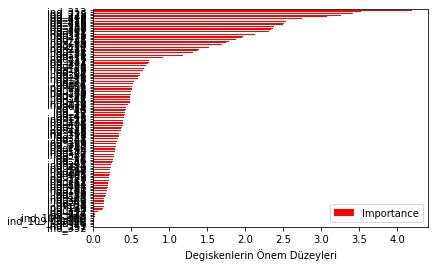

In [ ]:
# Degiskenlerin önem düzeylerine ihtiyacımız oldugunu düsünelim
Importance=pd.DataFrame({"Importance":rf_tuned.feature_importances_*100},
                       index=X_train.columns)
Importance.sort_values(by="Importance",
                       axis=0,
                       ascending=True).plot(kind="barh",
                                            color="r")

plt.xlabel("Degiskenlerin Önem Düzeyleri")

In [ ]:
# p  value değerleri anlamsız olanları atalım 

In [ ]:
lm = sm.OLS(y_train, X_train)
model_multi_linear = lm.fit()
print(model_multi_linear.summary())

                            OLS Regression Results                            
Dep. Variable:              90_target   R-squared:                       0.217
Model:                            OLS   Adj. R-squared:                  0.189
Method:                 Least Squares   F-statistic:                     7.751
Date:                Wed, 19 Aug 2020   Prob (F-statistic):          7.48e-119
Time:                        11:11:48   Log-Likelihood:                -18820.
No. Observations:                3844   AIC:                         3.791e+04
Df Residuals:                    3710   BIC:                         3.875e+04
Df Model:                         133                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
ind_5             1.0238      1.007      1.017

In [ ]:
X_train = X_train[model_multi_linear.pvalues[model_multi_linear.pvalues <  0.05].index]
X_test=X_test[model_multi_linear.pvalues[model_multi_linear.pvalues <  0.05].index]

In [ ]:
rf_model=RandomForestRegressor(random_state=42)

In [ ]:
rf_model.fit(X_train,y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=42, verbose=0, warm_start=False)

In [ ]:
y_pred=rf_model.predict(X_test)

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))# rmse

15.396059554402337

In [ ]:
mean_squared_error(y_test,y_pred)# mse

237.03864980270347

In [ ]:
mean_absolute_error(y_test,y_pred) # mae

8.691905601820855

In [ ]:
# model tuning aşaması

In [ ]:

rf_params={"max_depth":list(range(1,10)),
         "max_features":[3,5,10],
         "n_estimators":[100,200,500,1000]}#tahmin üretecek olan tahminci sayısı

In [ ]:
rf_model=RandomForestRegressor(random_state=42)

In [ ]:
rf_cv_model=GridSearchCV(rf_model,
                         rf_params
                         ,cv=10,
                         verbose=2,
                         n_jobs=-1)#islemcilerin tam performanslı kullanılmasını saglar

In [ ]:
rf_cv_model.fit(X_train,y_train)

Fitting 10 folds for each of 108 candidates, totalling 1080 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:   24.1s
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done 361 tasks      | elapsed:  6.4min
[Parallel(n_jobs=-1)]: Done 644 tasks      | elapsed: 14.4min
[Parallel(n_jobs=-1)]: Done 1009 tasks      | elapsed: 29.0min
[Parallel(n_jobs=-1)]: Done 1080 out of 1080 | elapsed: 33.5min finished


GridSearchCV(cv=10, error_score=nan,
             estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0,
                                             criterion='mse', max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             max_samples=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators=100, n_jobs=None,
                                             oob_score=False, random_state=42,
                                             verbose=0, warm_start=False),
             iid='deprecated', n_job

In [ ]:
rf_cv_model.best_params_


{'max_depth': 9, 'max_features': 10, 'n_estimators': 100}

In [ ]:
rf_tuned=RandomForestRegressor(max_depth= 9, max_features=10,n_estimators=100)

In [ ]:
rf_tuned=rf_tuned.fit(X_train,y_train)


In [ ]:
y_pred=rf_tuned.predict(X_test)

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))# rmse

20.862801524319547

In [ ]:
mean_squared_error(y_test,y_pred)

435.25648744315

In [ ]:
mean_absolute_error(y_test,y_pred)

17.429826131512204

Text(0.5, 0, 'Degiskenlerin Önem Düzeyleri')

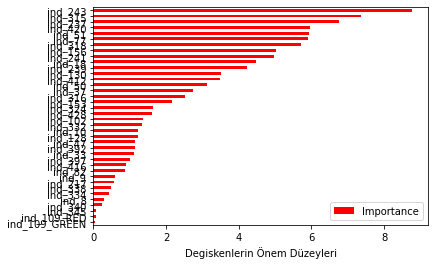

In [ ]:
# Degiskenlerin önem düzeylerine ihtiyacımız oldugunu düsünelim
Importance=pd.DataFrame({"Importance":rf_tuned.feature_importances_*100},
                       index=X_train.columns)
Importance.sort_values(by="Importance",
                       axis=0,
                       ascending=True).plot(kind="barh",
                                            color="r")

plt.xlabel("Degiskenlerin Önem Düzeyleri")

# Neural Network Regression

In [ ]:
df.replace("?",np.nan,inplace=True)
df=df.dropna()

In [ ]:
dms=pd.get_dummies(df[["ind_109"]])
dms.head()

,ind_109_GREEN,ind_109_RED
0,1,0
1,1,0
2,1,0
3,1,0
4,1,0


In [ ]:
y=df["90_target"]
X_=df.drop(["ind_109","50_target","90_target","20_target"],axis=1).astype('float64')
X=pd.concat([X_,dms[["ind_109_GREEN","ind_109_RED"]]],axis=1)
X.head()

,ind_5,ind_6,ind_8,ind_9,ind_10,ind_12,ind_13,ind_14,ind_15,ind_16,ind_17,ind_18,ind_19,ind_20,ind_21,ind_22,ind_23,ind_25,ind_26,ind_27,ind_28,ind_29,ind_30,ind_31,ind_32,ind_33,ind_34,ind_35,ind_36,ind_37,ind_39,ind_40,ind_41,ind_42,ind_43,ind_44,ind_45,ind_46,ind_47,ind_48,...,ind_310,ind_311,ind_313,ind_315,ind_316,ind_318,ind_321,ind_324,ind_327,ind_330,ind_332,ind_334,ind_338,ind_340,ind_344,ind_345,ind_347,ind_349,ind_351,ind_352,ind_387,ind_392,ind_397,ind_399,ind_403,ind_404,ind_406,ind_407,ind_410,ind_412,ind_414,ind_416,ind_418,ind_420,ind_422,ind_424,ind_426,ind_428,ind_109_GREEN,ind_109_RED
0,19.0,17.0,100.0,85.714286,14.285714,72.363515,60.808814,23.80,17.62,11.73,12.060000,9.1100,2.0,15.0,13.0,1.0,56.0,0.002690,-0.002670,0.000010,66.666667,93.692449,146.592674,150.505806,154.486989,158.009516,142.421114,142.023350,196.592517,184.819232,31.939605,3.0,30.752568,-5.0,-22.0,-22.0,-21.0,-23.0,-36.0,-40.0,...,-1.524694,97.980028,1.179209,-0.756946,98.905563,1.190348,99.156641,-0.000062,12.056738,-0.157039,20.967742,-0.000091,1.197238,-0.319064,0.0,0.0,0.0,0.0,0.0,0.0,-3.731343,-32.587430,-26.386973,-0.003323,0.045130,-0.044678,-44.0,-23.0,-27.0,0.002371,2.0,-49.6,-54.0,-152.0,-353.0,1.0,0.498547,0.701906,1,0
1,24.0,19.0,100.0,78.571429,21.428571,74.275883,64.366798,11.45,18.16,12.22,11.326667,9.2225,0.0,11.0,11.0,1.0,63.0,0.002729,-0.003111,-0.000191,66.666667,76.694104,140.227205,156.903278,161.604303,169.720843,152.634492,149.634976,201.738617,191.985663,38.478501,3.0,36.812130,-6.0,-18.0,-24.0,-24.0,-25.0,-38.0,-43.0,...,-1.523934,97.932319,1.179223,-0.756569,98.859627,1.190389,99.111914,-0.000062,11.971831,-0.156961,20.800000,-0.000091,1.197328,-0.318905,0.0,0.0,0.0,0.0,0.0,0.0,-1.369863,-38.115965,-26.085949,-0.000476,0.035314,-0.034961,-48.0,-16.0,-31.0,0.003074,0.8,-55.6,-60.0,-158.0,-359.0,1.0,0.537088,0.690833,1,0
2,30.0,24.0,100.0,71.428571,28.571429,75.140402,65.915803,8.75,17.86,12.28,10.973333,9.3125,5.0,15.0,9.0,-1.0,65.0,0.002780,-0.003530,-0.000375,66.666667,83.909974,117.755945,154.452274,164.015689,175.947530,160.181486,155.527932,205.238017,197.993551,28.917197,3.0,39.648290,-4.0,-11.0,-21.0,-22.0,-24.0,-36.0,-42.0,...,-1.523580,97.910664,1.179236,-0.756393,98.839991,1.190429,99.093554,-0.000062,11.888112,-0.156925,20.634921,-0.000091,1.197419,-0.318831,0.0,0.0,0.0,0.0,0.0,0.0,-4.278922,-40.428126,-23.250410,-0.000309,0.005860,-0.005802,-48.0,-10.0,-30.0,0.003561,2.7,-58.4,-60.0,-160.0,-362.0,1.0,0.615169,0.693040,1,0
3,37.0,30.0,100.0,64.285714,35.714286,76.677846,68.584234,7.80,14.76,12.61,10.426667,9.4150,11.0,18.0,8.0,0.0,68.0,0.002679,-0.003961,-0.000641,66.666667,98.596644,100.147384,139.695620,158.006863,171.688382,161.192133,156.413230,203.641362,200.370912,31.449631,3.0,40.902782,-5.0,-10.0,-21.0,-23.0,-26.0,-37.0,-44.0,...,-1.522935,97.870334,1.179249,-0.756073,98.801500,1.190469,99.056290,-0.000062,11.805556,-0.156858,20.472441,-0.000091,1.197509,-0.318696,0.0,0.0,0.0,0.0,0.0,0.0,-1.355422,-45.019355,-19.499975,0.001137,-0.018252,0.018070,-51.0,-10.0,-30.0,0.004366,0.9,-61.8,-65.0,-166.0,-367.0,1.0,0.661517,0.673418,1,0
4,41.0,37.0,100.0,57.142857,42.857143,81.603007,76.455495,14.90,11.92,14.25,11.406667,9.8925,13.0,23.0,10.0,10.0,91.0,0.003986,-0.004624,-0.000319,66.666667,149.283572,124.092409,168.275524,196.846256,208.017747,193.924291,184.995906,227.848369,223.561880,50.406504,2.0,48.462194,-18.0,-26.0,-37.0,-40.0,-43.0,-53.0,-61.0,...,-1.520349,97.705214,1.179263,-0.754789,98.637028,1.190509,98.892717,-0.000062,11.724138,-0.156592,20.312500,-0.000091,1.197600,-0.318155,0.0,0.0,0.0,0.0,0.0,0.0,-0.116144,-54.849177,-25.348270,0.001552,-0.007183,0.007111,-70.0,-24.0,-45.0,0.004198,0.1,-79.8,-86.0,-186.0,-388.0,1.0,0.747204,0.700522,1,0


In [ ]:
from sklearn.model_selection import train_test_split,cross_val_score,cross_val_predict
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.25,
                                              random_state=42)
print("X_train",X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)
training= df.copy()# tüm veri seti
print("training",training.shape)

X_train (3844, 134)
y_train (3844,)
X_test (1282, 134)
y_test (1282,)
training (5126, 136)


In [ ]:
# Tüm veri modele sokuldu
scaler=StandardScaler()
scaler.fit(X_train)

StandardScaler(copy=True, with_mean=True, with_std=True)

In [ ]:
X_train_scaled=scaler.transform(X_train)

In [ ]:
X_test_scaled=scaler.transform(X_test)

In [ ]:
mlp_model=MLPRegressor().fit(X_train,y_train)

In [ ]:
mlp_model

MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_fun=15000, max_iter=200,
             momentum=0.9, n_iter_no_change=10, nesterovs_momentum=True,
             power_t=0.5, random_state=None, shuffle=True, solver='adam',
             tol=0.0001, validation_fraction=0.1, verbose=False,
             warm_start=False)

In [ ]:
mlp_model.n_layers_

3

In [ ]:
mlp_model.hidden_layer_sizes


(100,)

In [ ]:
y_pred=mlp_model.predict(X_test_scaled)

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))

42.81268568052642

In [ ]:
mean_squared_error(y_test,y_pred)

1832.9260551795521

In [ ]:
mean_absolute_error(y_test,y_pred)

36.56047612436062

In [ ]:
mlp_params={"alpha":[0.1,0.01,0.02,0.005],
           "hidden_layer_sizes":[(20,20),(100,50,150),(300,200,150)],
           "activation":["relu","logistic"]}

In [ ]:
mlp_cv_model=GridSearchCV(mlp_model,mlp_params,cv=10,verbose=2,n_jobs=-1)

In [ ]:
mlp_cv_model.fit(X_train_scaled,y_train)

Fitting 10 folds for each of 24 candidates, totalling 240 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:  4.5min
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed: 25.7min
[Parallel(n_jobs=-1)]: Done 240 out of 240 | elapsed: 50.0min finished


GridSearchCV(cv=10, error_score=nan,
             estimator=MLPRegressor(activation='relu', alpha=0.0001,
                                    batch_size='auto', beta_1=0.9, beta_2=0.999,
                                    early_stopping=False, epsilon=1e-08,
                                    hidden_layer_sizes=(100,),
                                    learning_rate='constant',
                                    learning_rate_init=0.001, max_fun=15000,
                                    max_iter=200, momentum=0.9,
                                    n_iter_no_change=10,
                                    nesterovs_momentum=True, power_t=0.5,
                                    random_state=None, shuffle=True,
                                    solver='adam', tol=0.0001,
                                    validation_fraction=0.1, verbose=False,
                                    warm_start=False),
             iid='deprecated', n_jobs=-1,
             param_grid={'activation':

In [ ]:
mlp_cv_model.best_params_

{'activation': 'relu', 'alpha': 0.01, 'hidden_layer_sizes': (300, 200, 150)}

In [ ]:
mlp_tuned=MLPRegressor(alpha= 0.01,activation="relu",hidden_layer_sizes=(300, 200, 150))

In [ ]:
mlp_tuned.fit(X_train_scaled,y_train)

MLPRegressor(activation='relu', alpha=0.01, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(300, 200, 150), learning_rate='constant',
             learning_rate_init=0.001, max_fun=15000, max_iter=200,
             momentum=0.9, n_iter_no_change=10, nesterovs_momentum=True,
             power_t=0.5, random_state=None, shuffle=True, solver='adam',
             tol=0.0001, validation_fraction=0.1, verbose=False,
             warm_start=False)

In [ ]:
y_pred=mlp_tuned.predict(X_test_scaled)

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))

20.583771375068377

In [ ]:
mean_squared_error(y_test,y_pred)

423.69164402108436

In [ ]:
mean_absolute_error(y_test,y_pred)

11.992615693169638

In [ ]:
# p value değerleri anlamlı olmayan değişkenler atılır
lm = sm.OLS(y_train, X_train)
model_multi_linear = lm.fit()
print(model_multi_linear.summary())

                            OLS Regression Results                            
Dep. Variable:              90_target   R-squared:                       0.217
Model:                            OLS   Adj. R-squared:                  0.189
Method:                 Least Squares   F-statistic:                     7.751
Date:                Wed, 19 Aug 2020   Prob (F-statistic):          7.48e-119
Time:                        13:16:04   Log-Likelihood:                -18820.
No. Observations:                3844   AIC:                         3.791e+04
Df Residuals:                    3710   BIC:                         3.875e+04
Df Model:                         133                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
ind_5             1.0238      1.007      1.017

In [ ]:
X_train = X_train[model_multi_linear.pvalues[model_multi_linear.pvalues <  0.05].index]
X_test=X_test[model_multi_linear.pvalues[model_multi_linear.pvalues <  0.05].index]

In [ ]:
scaler=StandardScaler()
scaler.fit(X_train)

StandardScaler(copy=True, with_mean=True, with_std=True)

In [ ]:
X_train_scaled=scaler.transform(X_train)

In [ ]:
X_test_scaled=scaler.transform(X_test)

In [ ]:
mlp_model=MLPRegressor().fit(X_train,y_train)

In [ ]:
mlp_model

MLPRegressor(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(100,), learning_rate='constant',
             learning_rate_init=0.001, max_fun=15000, max_iter=200,
             momentum=0.9, n_iter_no_change=10, nesterovs_momentum=True,
             power_t=0.5, random_state=None, shuffle=True, solver='adam',
             tol=0.0001, validation_fraction=0.1, verbose=False,
             warm_start=False)

In [ ]:
mlp_model.n_layers_

3

In [ ]:
mlp_model.hidden_layer_sizes


(100,)

In [ ]:
y_pred=mlp_model.predict(X_test_scaled)

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))

55.55219253957649

In [ ]:
mean_squared_error(y_test,y_pred)

3086.046095954178

In [ ]:
mean_absolute_error(y_test,y_pred)

41.95179508216243

In [ ]:
mlp_params={"alpha":[0.1,0.01,0.02,0.005],
           "hidden_layer_sizes":[(20,20),(100,50,150),(300,200,150)],
           "activation":["relu","logistic"]}

In [ ]:
mlp_cv_model=GridSearchCV(mlp_model,mlp_params,cv=10,verbose=2,n_jobs=-1)

In [ ]:
mlp_cv_model.fit(X_train_scaled,y_train)

Fitting 10 folds for each of 24 candidates, totalling 240 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:  4.6min
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed: 24.7min
[Parallel(n_jobs=-1)]: Done 240 out of 240 | elapsed: 46.5min finished


GridSearchCV(cv=10, error_score=nan,
             estimator=MLPRegressor(activation='relu', alpha=0.0001,
                                    batch_size='auto', beta_1=0.9, beta_2=0.999,
                                    early_stopping=False, epsilon=1e-08,
                                    hidden_layer_sizes=(100,),
                                    learning_rate='constant',
                                    learning_rate_init=0.001, max_fun=15000,
                                    max_iter=200, momentum=0.9,
                                    n_iter_no_change=10,
                                    nesterovs_momentum=True, power_t=0.5,
                                    random_state=None, shuffle=True,
                                    solver='adam', tol=0.0001,
                                    validation_fraction=0.1, verbose=False,
                                    warm_start=False),
             iid='deprecated', n_jobs=-1,
             param_grid={'activation':

In [ ]:
mlp_cv_model.best_params_

{'activation': 'relu', 'alpha': 0.01, 'hidden_layer_sizes': (300, 200, 150)}

In [ ]:
mlp_tuned=MLPRegressor(alpha= 0.01,activation="relu",hidden_layer_sizes=(300, 200, 150))

In [ ]:
mlp_tuned.fit(X_train_scaled,y_train)

MLPRegressor(activation='relu', alpha=0.01, batch_size='auto', beta_1=0.9,
             beta_2=0.999, early_stopping=False, epsilon=1e-08,
             hidden_layer_sizes=(300, 200, 150), learning_rate='constant',
             learning_rate_init=0.001, max_fun=15000, max_iter=200,
             momentum=0.9, n_iter_no_change=10, nesterovs_momentum=True,
             power_t=0.5, random_state=None, shuffle=True, solver='adam',
             tol=0.0001, validation_fraction=0.1, verbose=False,
             warm_start=False)

In [ ]:
y_pred=mlp_tuned.predict(X_test_scaled)

In [ ]:
np.sqrt(mean_squared_error(y_test,y_pred))

18.846102489341884

In [ ]:
mean_squared_error(y_test,y_pred)

355.1755790387784

In [ ]:
mean_absolute_error(y_test,y_pred)

11.136952004697706

In [ ]:
# Support Vector Regressor

In [23]:
df.replace("?",np.nan,inplace=True)
df=df.dropna()

In [24]:
dms=pd.get_dummies(df[["ind_109"]])
dms.head()

,ind_109_GREEN,ind_109_RED
0,1,0
1,1,0
2,1,0
3,1,0
4,1,0


In [25]:
y=df["90_target"]
X_=df.drop(["ind_109","50_target","90_target","20_target"],axis=1).astype('float64')
X=pd.concat([X_,dms[["ind_109_GREEN","ind_109_RED"]]],axis=1)
X.head()

,ind_5,ind_6,ind_8,ind_9,ind_10,ind_12,ind_13,ind_14,ind_15,ind_16,ind_17,ind_18,ind_19,ind_20,ind_21,ind_22,ind_23,ind_25,ind_26,ind_27,ind_28,ind_29,ind_30,ind_31,ind_32,ind_33,ind_34,ind_35,ind_36,ind_37,ind_39,ind_40,ind_41,ind_42,ind_43,ind_44,ind_45,ind_46,ind_47,ind_48,...,ind_310,ind_311,ind_313,ind_315,ind_316,ind_318,ind_321,ind_324,ind_327,ind_330,ind_332,ind_334,ind_338,ind_340,ind_344,ind_345,ind_347,ind_349,ind_351,ind_352,ind_387,ind_392,ind_397,ind_399,ind_403,ind_404,ind_406,ind_407,ind_410,ind_412,ind_414,ind_416,ind_418,ind_420,ind_422,ind_424,ind_426,ind_428,ind_109_GREEN,ind_109_RED
0,19.0,17.0,100.0,85.714286,14.285714,72.363515,60.808814,23.80,17.62,11.73,12.060000,9.1100,2.0,15.0,13.0,1.0,56.0,0.002690,-0.002670,0.000010,66.666667,93.692449,146.592674,150.505806,154.486989,158.009516,142.421114,142.023350,196.592517,184.819232,31.939605,3.0,30.752568,-5.0,-22.0,-22.0,-21.0,-23.0,-36.0,-40.0,...,-1.524694,97.980028,1.179209,-0.756946,98.905563,1.190348,99.156641,-0.000062,12.056738,-0.157039,20.967742,-0.000091,1.197238,-0.319064,0.0,0.0,0.0,0.0,0.0,0.0,-3.731343,-32.587430,-26.386973,-0.003323,0.045130,-0.044678,-44.0,-23.0,-27.0,0.002371,2.0,-49.6,-54.0,-152.0,-353.0,1.0,0.498547,0.701906,1,0
1,24.0,19.0,100.0,78.571429,21.428571,74.275883,64.366798,11.45,18.16,12.22,11.326667,9.2225,0.0,11.0,11.0,1.0,63.0,0.002729,-0.003111,-0.000191,66.666667,76.694104,140.227205,156.903278,161.604303,169.720843,152.634492,149.634976,201.738617,191.985663,38.478501,3.0,36.812130,-6.0,-18.0,-24.0,-24.0,-25.0,-38.0,-43.0,...,-1.523934,97.932319,1.179223,-0.756569,98.859627,1.190389,99.111914,-0.000062,11.971831,-0.156961,20.800000,-0.000091,1.197328,-0.318905,0.0,0.0,0.0,0.0,0.0,0.0,-1.369863,-38.115965,-26.085949,-0.000476,0.035314,-0.034961,-48.0,-16.0,-31.0,0.003074,0.8,-55.6,-60.0,-158.0,-359.0,1.0,0.537088,0.690833,1,0
2,30.0,24.0,100.0,71.428571,28.571429,75.140402,65.915803,8.75,17.86,12.28,10.973333,9.3125,5.0,15.0,9.0,-1.0,65.0,0.002780,-0.003530,-0.000375,66.666667,83.909974,117.755945,154.452274,164.015689,175.947530,160.181486,155.527932,205.238017,197.993551,28.917197,3.0,39.648290,-4.0,-11.0,-21.0,-22.0,-24.0,-36.0,-42.0,...,-1.523580,97.910664,1.179236,-0.756393,98.839991,1.190429,99.093554,-0.000062,11.888112,-0.156925,20.634921,-0.000091,1.197419,-0.318831,0.0,0.0,0.0,0.0,0.0,0.0,-4.278922,-40.428126,-23.250410,-0.000309,0.005860,-0.005802,-48.0,-10.0,-30.0,0.003561,2.7,-58.4,-60.0,-160.0,-362.0,1.0,0.615169,0.693040,1,0
3,37.0,30.0,100.0,64.285714,35.714286,76.677846,68.584234,7.80,14.76,12.61,10.426667,9.4150,11.0,18.0,8.0,0.0,68.0,0.002679,-0.003961,-0.000641,66.666667,98.596644,100.147384,139.695620,158.006863,171.688382,161.192133,156.413230,203.641362,200.370912,31.449631,3.0,40.902782,-5.0,-10.0,-21.0,-23.0,-26.0,-37.0,-44.0,...,-1.522935,97.870334,1.179249,-0.756073,98.801500,1.190469,99.056290,-0.000062,11.805556,-0.156858,20.472441,-0.000091,1.197509,-0.318696,0.0,0.0,0.0,0.0,0.0,0.0,-1.355422,-45.019355,-19.499975,0.001137,-0.018252,0.018070,-51.0,-10.0,-30.0,0.004366,0.9,-61.8,-65.0,-166.0,-367.0,1.0,0.661517,0.673418,1,0
4,41.0,37.0,100.0,57.142857,42.857143,81.603007,76.455495,14.90,11.92,14.25,11.406667,9.8925,13.0,23.0,10.0,10.0,91.0,0.003986,-0.004624,-0.000319,66.666667,149.283572,124.092409,168.275524,196.846256,208.017747,193.924291,184.995906,227.848369,223.561880,50.406504,2.0,48.462194,-18.0,-26.0,-37.0,-40.0,-43.0,-53.0,-61.0,...,-1.520349,97.705214,1.179263,-0.754789,98.637028,1.190509,98.892717,-0.000062,11.724138,-0.156592,20.312500,-0.000091,1.197600,-0.318155,0.0,0.0,0.0,0.0,0.0,0.0,-0.116144,-54.849177,-25.348270,0.001552,-0.007183,0.007111,-70.0,-24.0,-45.0,0.004198,0.1,-79.8,-86.0,-186.0,-388.0,1.0,0.747204,0.700522,1,0


In [26]:
from sklearn.model_selection import train_test_split,cross_val_score,cross_val_predict
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.25,
                                              random_state=42)
print("X_train",X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)
training= df.copy()# tüm veri seti
print("training",training.shape)

X_train (3844, 134)
y_train (3844,)
X_test (1282, 134)
y_test (1282,)
training (5126, 136)


In [27]:
X_train=preprocessing.scale(X_train)
y_train=preprocessing.scale(y_train)


In [28]:
svr_model = SVR(kernel="linear").fit(X_train,y_train)

In [29]:
svr_model.predict(X_train )[0:5]

array([ 0.14024941, -0.40145719,  0.60843197, -0.15077791,  0.21480277])

In [30]:
y_pred = svr_model.predict(X_test)


In [31]:
np.sqrt(mean_squared_error(y_test, y_pred))

145.96308070302342

In [32]:
mean_squared_error(y_test,y_pred)

21305.22092831733

In [33]:
mean_absolute_error(y_test,y_pred)

120.40522441076969

In [34]:
# model tuning 

In [35]:
svr_params = {"C": [0.01, 0.05, 0.1,1, 5, 10],"kernel":["linear", "rbf", "sigmoid"]}
svr_cv_model = GridSearchCV(svr_model, svr_params, cv=10, n_jobs=-1,verbose=2).fit(X_train, y_train)



Fitting 10 folds for each of 18 candidates, totalling 180 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed: 31.4min
[Parallel(n_jobs=-1)]: Done 180 out of 180 | elapsed: 35.8min finished


In [36]:
print(svr_cv_model.best_params_)

{'C': 10, 'kernel': 'rbf'}


In [38]:
svr_tuned = SVR(C=10, kernel="rbf").fit(X_train,y_train)
y_pred = svr_tuned.predict(X_test)


In [39]:
np.sqrt(mean_squared_error(y_test, y_pred))

36.948227278660966

In [40]:
mean_squared_error(y_test,y_pred)

1365.1714990355863

In [41]:
mean_absolute_error(y_test,y_pred)

36.720699162161644

In [ ]:
# p value değerleri anlamlı olmayanlar atılır


In [48]:
df.replace("?",np.nan,inplace=True)
df=df.dropna()

In [49]:
dms=pd.get_dummies(df[["ind_109"]])
dms.head()

,ind_109_GREEN,ind_109_RED
0,1,0
1,1,0
2,1,0
3,1,0
4,1,0


In [50]:
y=df["90_target"]
X_=df.drop(["ind_109","50_target","90_target","20_target"],axis=1).astype('float64')
X=pd.concat([X_,dms[["ind_109_GREEN","ind_109_RED"]]],axis=1)
X.head()

,ind_5,ind_6,ind_8,ind_9,ind_10,ind_12,ind_13,ind_14,ind_15,ind_16,ind_17,ind_18,ind_19,ind_20,ind_21,ind_22,ind_23,ind_25,ind_26,ind_27,ind_28,ind_29,ind_30,ind_31,ind_32,ind_33,ind_34,ind_35,ind_36,ind_37,ind_39,ind_40,ind_41,ind_42,ind_43,ind_44,ind_45,ind_46,ind_47,ind_48,...,ind_310,ind_311,ind_313,ind_315,ind_316,ind_318,ind_321,ind_324,ind_327,ind_330,ind_332,ind_334,ind_338,ind_340,ind_344,ind_345,ind_347,ind_349,ind_351,ind_352,ind_387,ind_392,ind_397,ind_399,ind_403,ind_404,ind_406,ind_407,ind_410,ind_412,ind_414,ind_416,ind_418,ind_420,ind_422,ind_424,ind_426,ind_428,ind_109_GREEN,ind_109_RED
0,19.0,17.0,100.0,85.714286,14.285714,72.363515,60.808814,23.80,17.62,11.73,12.060000,9.1100,2.0,15.0,13.0,1.0,56.0,0.002690,-0.002670,0.000010,66.666667,93.692449,146.592674,150.505806,154.486989,158.009516,142.421114,142.023350,196.592517,184.819232,31.939605,3.0,30.752568,-5.0,-22.0,-22.0,-21.0,-23.0,-36.0,-40.0,...,-1.524694,97.980028,1.179209,-0.756946,98.905563,1.190348,99.156641,-0.000062,12.056738,-0.157039,20.967742,-0.000091,1.197238,-0.319064,0.0,0.0,0.0,0.0,0.0,0.0,-3.731343,-32.587430,-26.386973,-0.003323,0.045130,-0.044678,-44.0,-23.0,-27.0,0.002371,2.0,-49.6,-54.0,-152.0,-353.0,1.0,0.498547,0.701906,1,0
1,24.0,19.0,100.0,78.571429,21.428571,74.275883,64.366798,11.45,18.16,12.22,11.326667,9.2225,0.0,11.0,11.0,1.0,63.0,0.002729,-0.003111,-0.000191,66.666667,76.694104,140.227205,156.903278,161.604303,169.720843,152.634492,149.634976,201.738617,191.985663,38.478501,3.0,36.812130,-6.0,-18.0,-24.0,-24.0,-25.0,-38.0,-43.0,...,-1.523934,97.932319,1.179223,-0.756569,98.859627,1.190389,99.111914,-0.000062,11.971831,-0.156961,20.800000,-0.000091,1.197328,-0.318905,0.0,0.0,0.0,0.0,0.0,0.0,-1.369863,-38.115965,-26.085949,-0.000476,0.035314,-0.034961,-48.0,-16.0,-31.0,0.003074,0.8,-55.6,-60.0,-158.0,-359.0,1.0,0.537088,0.690833,1,0
2,30.0,24.0,100.0,71.428571,28.571429,75.140402,65.915803,8.75,17.86,12.28,10.973333,9.3125,5.0,15.0,9.0,-1.0,65.0,0.002780,-0.003530,-0.000375,66.666667,83.909974,117.755945,154.452274,164.015689,175.947530,160.181486,155.527932,205.238017,197.993551,28.917197,3.0,39.648290,-4.0,-11.0,-21.0,-22.0,-24.0,-36.0,-42.0,...,-1.523580,97.910664,1.179236,-0.756393,98.839991,1.190429,99.093554,-0.000062,11.888112,-0.156925,20.634921,-0.000091,1.197419,-0.318831,0.0,0.0,0.0,0.0,0.0,0.0,-4.278922,-40.428126,-23.250410,-0.000309,0.005860,-0.005802,-48.0,-10.0,-30.0,0.003561,2.7,-58.4,-60.0,-160.0,-362.0,1.0,0.615169,0.693040,1,0
3,37.0,30.0,100.0,64.285714,35.714286,76.677846,68.584234,7.80,14.76,12.61,10.426667,9.4150,11.0,18.0,8.0,0.0,68.0,0.002679,-0.003961,-0.000641,66.666667,98.596644,100.147384,139.695620,158.006863,171.688382,161.192133,156.413230,203.641362,200.370912,31.449631,3.0,40.902782,-5.0,-10.0,-21.0,-23.0,-26.0,-37.0,-44.0,...,-1.522935,97.870334,1.179249,-0.756073,98.801500,1.190469,99.056290,-0.000062,11.805556,-0.156858,20.472441,-0.000091,1.197509,-0.318696,0.0,0.0,0.0,0.0,0.0,0.0,-1.355422,-45.019355,-19.499975,0.001137,-0.018252,0.018070,-51.0,-10.0,-30.0,0.004366,0.9,-61.8,-65.0,-166.0,-367.0,1.0,0.661517,0.673418,1,0
4,41.0,37.0,100.0,57.142857,42.857143,81.603007,76.455495,14.90,11.92,14.25,11.406667,9.8925,13.0,23.0,10.0,10.0,91.0,0.003986,-0.004624,-0.000319,66.666667,149.283572,124.092409,168.275524,196.846256,208.017747,193.924291,184.995906,227.848369,223.561880,50.406504,2.0,48.462194,-18.0,-26.0,-37.0,-40.0,-43.0,-53.0,-61.0,...,-1.520349,97.705214,1.179263,-0.754789,98.637028,1.190509,98.892717,-0.000062,11.724138,-0.156592,20.312500,-0.000091,1.197600,-0.318155,0.0,0.0,0.0,0.0,0.0,0.0,-0.116144,-54.849177,-25.348270,0.001552,-0.007183,0.007111,-70.0,-24.0,-45.0,0.004198,0.1,-79.8,-86.0,-186.0,-388.0,1.0,0.747204,0.700522,1,0


In [51]:
from sklearn.model_selection import train_test_split,cross_val_score,cross_val_predict
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.25,
                                              random_state=42)
print("X_train",X_train.shape)
print("y_train",y_train.shape)
print("X_test",X_test.shape)
print("y_test",y_test.shape)
training= df.copy()# tüm veri seti
print("training",training.shape)

X_train (3844, 134)
y_train (3844,)
X_test (1282, 134)
y_test (1282,)
training (5126, 136)


In [52]:
# p value değerleri anlamlı olmayan değişkenler atılır
lm = sm.OLS(y_train, X_train)
model_multi_linear = lm.fit()
print(model_multi_linear.summary())

                            OLS Regression Results                            
Dep. Variable:              90_target   R-squared:                       0.217
Model:                            OLS   Adj. R-squared:                  0.189
Method:                 Least Squares   F-statistic:                     7.751
Date:                Thu, 20 Aug 2020   Prob (F-statistic):          7.48e-119
Time:                        19:39:14   Log-Likelihood:                -18820.
No. Observations:                3844   AIC:                         3.791e+04
Df Residuals:                    3710   BIC:                         3.875e+04
Df Model:                         133                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
ind_5             1.0238      1.007      1.017

In [53]:
X_train = X_train[model_multi_linear.pvalues[model_multi_linear.pvalues <  0.05].index]
X_test=X_test[model_multi_linear.pvalues[model_multi_linear.pvalues <  0.05].index]

In [54]:
X_train=preprocessing.scale(X_train)
y_train=preprocessing.scale(y_train)


In [55]:
svr_model = SVR(kernel="linear").fit(X_train,y_train)

In [56]:
svr_model.predict(X_train )[0:5]

array([ 0.33288953, -0.50267872,  0.83125562,  0.37599024, -0.05441314])

In [57]:
y_pred = svr_model.predict(X_test)


In [58]:
np.sqrt(mean_squared_error(y_test, y_pred))

128.291417519444

In [59]:
mean_squared_error(y_test,y_pred)

16458.6878091483

In [60]:
mean_absolute_error(y_test,y_pred)

104.5495988838672

In [ ]:
# model tuning 


In [61]:
svr_params = {"C": [0.01, 0.05, 0.1,1, 5, 10],"kernel":["linear", "rbf", "sigmoid"]}
svr_cv_model = GridSearchCV(svr_model, svr_params, cv=10, n_jobs=-1,verbose=2).fit(X_train, y_train)



Fitting 10 folds for each of 18 candidates, totalling 180 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:   31.8s
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed:  7.2min
[Parallel(n_jobs=-1)]: Done 180 out of 180 | elapsed:  8.3min finished


In [62]:
print(svr_cv_model.best_params_)

{'C': 10, 'kernel': 'rbf'}


In [63]:
svr_tuned = SVR(C=10, kernel="rbf").fit(X_train,y_train)
y_pred = svr_tuned.predict(X_test)


In [64]:
np.sqrt(mean_squared_error(y_test, y_pred))

36.926102484175374

In [65]:
mean_squared_error(y_test, y_pred)

1363.5370446718227

In [66]:
mean_absolute_error(y_test,y_pred)

36.70070581131948